## Data Challenge
- Data collected at 50Hz for ~100 seconds, so ~5000 samples in total in each take. There are 51 takes.
- Input data is from reflective optical sensors from the wrist area and has 30 dimensions, taking values with 10-bit resolution (0 ~ 1024) but mostly in range 100 - 500
- Label data has 5 dimensions (one for each finger) and the value is calculated as a dot product between 2 (normalized) vectors (-1 ~ 1)
- We can assume that during data collection, the fingers are pointing straight forward

*You will be judged on model results and your approach*

- [ ] Import data & perform exploratory data analysis

In [185]:
import joblib

features, labels = joblib.load("data.dat")

In [3]:
for i in range(len(features)):
    print(f"Feature {i+1} has shape {features[i].shape}")


Feature 1 has shape (4979, 30)
Feature 2 has shape (4966, 30)
Feature 3 has shape (4944, 30)
Feature 4 has shape (4966, 30)
Feature 5 has shape (4966, 30)
Feature 6 has shape (4958, 30)
Feature 7 has shape (5000, 30)
Feature 8 has shape (5000, 30)
Feature 9 has shape (4937, 30)
Feature 10 has shape (4959, 30)
Feature 11 has shape (5000, 30)
Feature 12 has shape (5000, 30)
Feature 13 has shape (5000, 30)
Feature 14 has shape (5000, 30)
Feature 15 has shape (5000, 30)
Feature 16 has shape (5000, 30)
Feature 17 has shape (5000, 30)
Feature 18 has shape (4974, 30)
Feature 19 has shape (5000, 30)
Feature 20 has shape (5000, 30)
Feature 21 has shape (5000, 30)
Feature 22 has shape (5000, 30)
Feature 23 has shape (5000, 30)
Feature 24 has shape (5000, 30)
Feature 25 has shape (5000, 30)
Feature 26 has shape (5000, 30)
Feature 27 has shape (5000, 30)
Feature 28 has shape (5000, 30)
Feature 29 has shape (5000, 30)
Feature 30 has shape (5000, 30)
Feature 31 has shape (5000, 30)
Feature 32 has sh

In [4]:
for i in range(len(labels)):
    print(f"Label {i+1} has shape {labels[i].shape}")

Label 1 has shape (4979, 5)
Label 2 has shape (4966, 5)
Label 3 has shape (4944, 5)
Label 4 has shape (4966, 5)
Label 5 has shape (4966, 5)
Label 6 has shape (4958, 5)
Label 7 has shape (5000, 5)
Label 8 has shape (5000, 5)
Label 9 has shape (4937, 5)
Label 10 has shape (4959, 5)
Label 11 has shape (5000, 5)
Label 12 has shape (5000, 5)
Label 13 has shape (5000, 5)
Label 14 has shape (5000, 5)
Label 15 has shape (5000, 5)
Label 16 has shape (5000, 5)
Label 17 has shape (5000, 5)
Label 18 has shape (4974, 5)
Label 19 has shape (5000, 5)
Label 20 has shape (5000, 5)
Label 21 has shape (5000, 5)
Label 22 has shape (5000, 5)
Label 23 has shape (5000, 5)
Label 24 has shape (5000, 5)
Label 25 has shape (5000, 5)
Label 26 has shape (5000, 5)
Label 27 has shape (5000, 5)
Label 28 has shape (5000, 5)
Label 29 has shape (5000, 5)
Label 30 has shape (5000, 5)
Label 31 has shape (5000, 5)
Label 32 has shape (5000, 5)
Label 33 has shape (5000, 5)
Label 34 has shape (5000, 5)
Label 35 has shape (500

In [5]:
# Verify the signals & labels match up
for i in range(len(features)):
    if features[i].shape[0] != labels[i].shape[0]:
        print(f"Feature {i+1} has shape {features[i].shape} but label {i+1} has shape {labels[i].shape}")

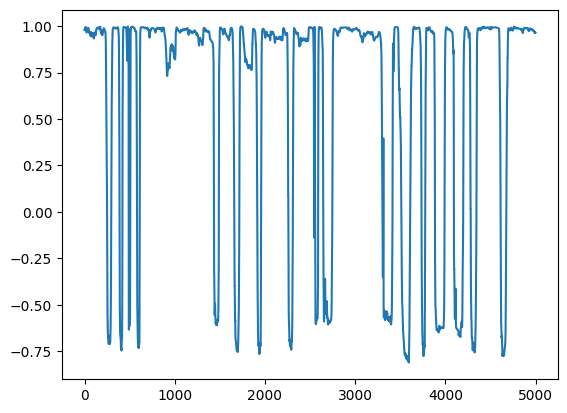

In [6]:
import matplotlib.pyplot as plt

take = 10

N = len(labels[take])
x = list(range(N))
y = labels[take][:,2] # Thumb

fig, ax = plt.subplots()
ax.plot(x,y)
plt.show()

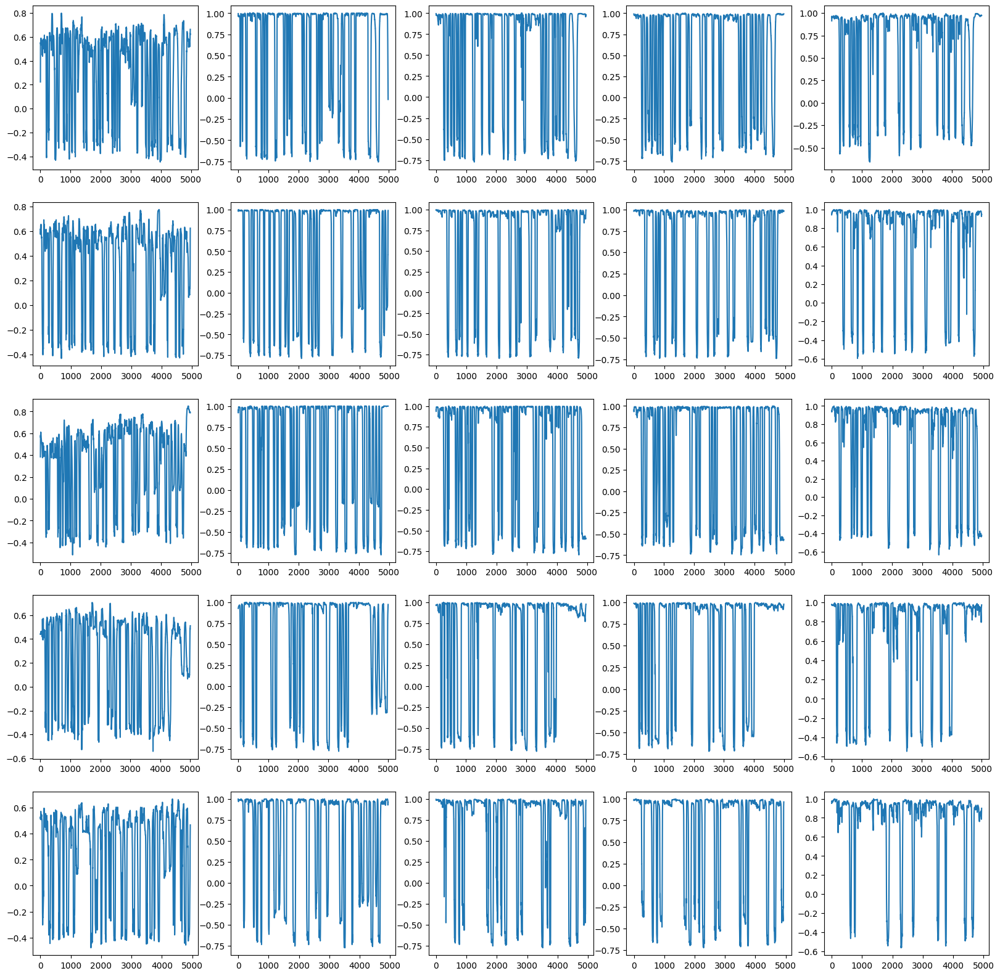

In [7]:
takes = [0,2,4,6,8]
unit = 4 # Unit size of plots
plt.figure(figsize=(5*unit, len(takes)*unit))
for i in range(len(takes)):
    for j in range(5):
        y = labels[takes[i]][:,j]
        plt.subplot(5, 5, i*5 + j+1)
        # print(i*5+j+1)
        plt.plot(list(range(len(y))),y)
plt.show()


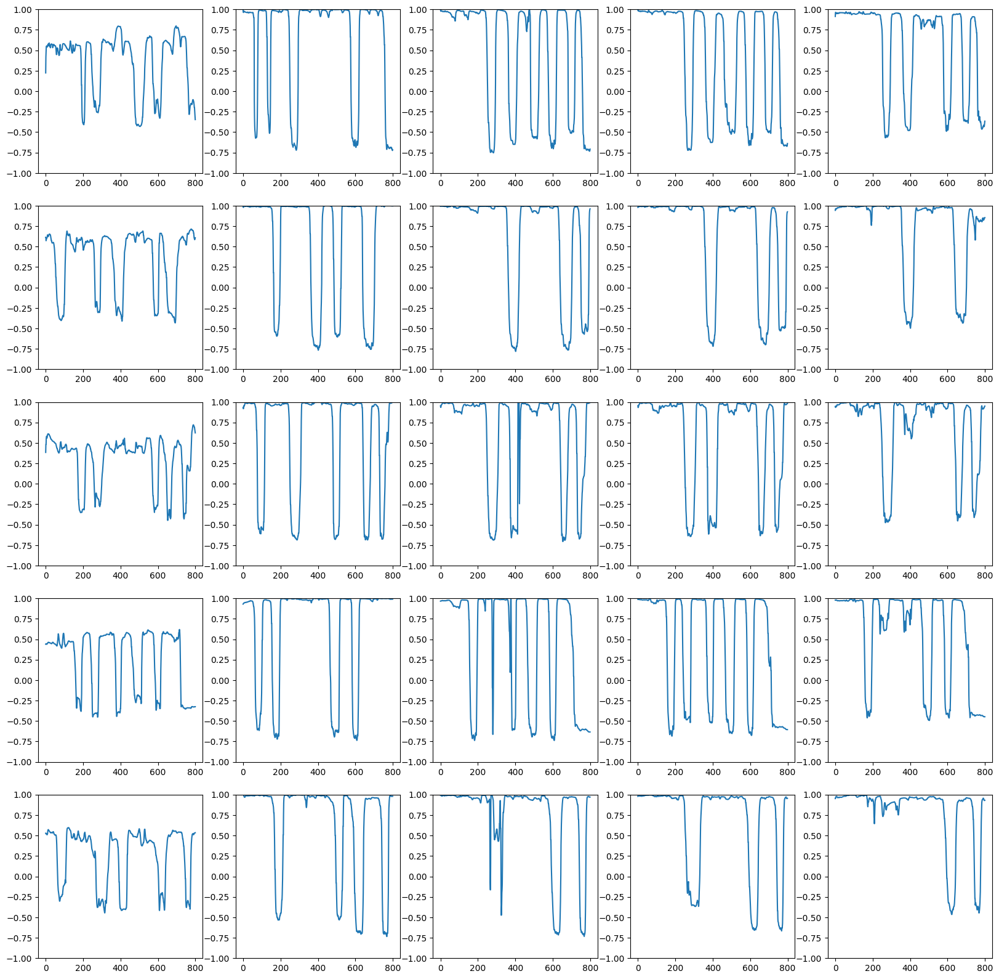

In [8]:
takes = [0,2,4,6,8]
unit = 4 # Unit size of plots
plt.figure(figsize=(5*unit, len(takes)*unit))
for i in range(len(takes)):
    for j in range(5):
        y = labels[takes[i]][:800,j]
        plt.subplot(5, 5, i*5 + j+1)
        plt.ylim([-1, 1])
        plt.plot(list(range(len(y))),y)
plt.show()


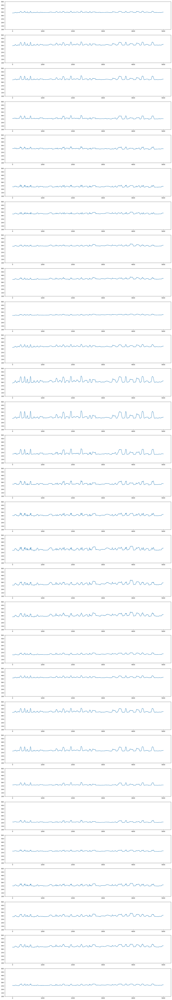

In [9]:
take = 10
unit = 4

num_features = features[0].shape[1]
plt.figure(figsize=(5*unit, num_features*unit))
for i in range(num_features):
    y = features[take][:,i]
    plt.subplot(num_features, 1, i+1)
    plt.ylim([100, 500])
    plt.plot(list(range(len(y))), y)
plt.show()


In [10]:

# Find correlation between features
import torch

# Just take first 8 features
samples = torch.tensor(features[0]).t()[:8,:]  # Shape 30 x 5000

# Matrix of Pearson's correlation coefficient
cov_mat = torch.corrcoef(samples)
print(cov_mat)

tensor([[1.0000, 0.9567, 0.9052, 0.8126, 0.7380, 0.6544, 0.3450, 0.5377],
        [0.9567, 1.0000, 0.9818, 0.9167, 0.8575, 0.7797, 0.4352, 0.5834],
        [0.9052, 0.9818, 1.0000, 0.9640, 0.9120, 0.8061, 0.4025, 0.5231],
        [0.8126, 0.9167, 0.9640, 1.0000, 0.9826, 0.8748, 0.4381, 0.4961],
        [0.7380, 0.8575, 0.9120, 0.9826, 1.0000, 0.9130, 0.4881, 0.5098],
        [0.6544, 0.7797, 0.8061, 0.8748, 0.9130, 1.0000, 0.7860, 0.7488],
        [0.3450, 0.4352, 0.4025, 0.4381, 0.4881, 0.7860, 1.0000, 0.9053],
        [0.5377, 0.5834, 0.5231, 0.4961, 0.5098, 0.7488, 0.9053, 1.0000]],
       dtype=torch.float64)


In [11]:
# Linear baseline model
from sklearn.linear_model import LinearRegression
import numpy as np

# Linear regression example
X = np.array([[1, 1], [1, 2], [2, 2], [2, 3]])  # Each row is a datapoint
# y = 1 * x_0 + 2 * x_1 + 3
y = np.dot(X, np.array([2,2])) + 3
reg = LinearRegression().fit(X,y)
print(reg.score(X,y))
print(reg.coef_)
print(reg.intercept_)
print(reg.predict(np.array([[3,5]])))

1.0
[2. 2.]
3.0
[19.]


In [12]:
# Let's predict the index finger
features_train, labels_train = np.vstack(features[:40]), np.vstack(labels[:40])[:,1]
features_test, labels_test = np.vstack(features[40:]), np.vstack(labels[40:])[:,1]

print(features_train.shape)
print(labels_train.shape)
print(features_test.shape)
print(labels_test.shape)

reg = LinearRegression().fit(features_train, labels_train)
print(reg.score(features_test,labels_test))
print(reg.coef_)
print(reg.intercept_)

preds = reg.predict(features_test)

(199649, 30)
(199649,)
(55000, 30)
(55000,)
-0.24508146028350009
[ 1.99774428e-02 -2.38733794e-02  4.85581252e-03  1.62327552e-02
 -1.40369609e-02 -1.64735009e-02  8.42026528e-02 -4.20007809e-02
 -8.53169873e-05  1.12265229e-02 -2.40673924e-03 -2.81294219e-02
  2.80221954e-02 -8.55474556e-03  2.04089901e-02 -5.94924445e-02
 -4.57398462e-02  3.48837742e-02  4.03781923e-02 -1.00814850e-02
 -1.20102839e-02  3.02583314e-03  7.89429171e-03 -2.44822924e-02
 -4.69195684e-02  1.24825092e-01  1.90738282e-02 -6.33667161e-02
 -2.53216136e-02  2.71877481e-02]
-2.7659261309598593


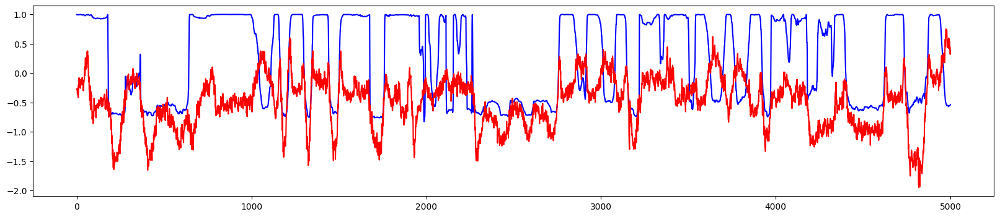

In [12]:
show_length = 5000

plt.figure(figsize=(5*unit, unit))
y = labels_test[:show_length]
plt.plot(list(range(show_length)), y, 'b', list(range(show_length)), preds[:show_length], 'r')
plt.show()

In [13]:
# Now let's try this for all fingers

models = [None]*5 # List of Linear models for each finger in order

features_train = np.vstack(features[:40])
features_test = np.vstack(features[40:])
labels_test = np.vstack(labels[40:])

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train, labels_train)
    models[i] = reg

In [14]:
def cap(x, min, max):
    if x < min:
        return min
    elif x > max:
        return max
    else:
        return x

In [16]:
from sklearn.metrics import r2_score


def get_model_metrics(models, features_test, labels_test, offset=0, use_capping=False, print_graph=True):
    plt.figure(figsize=(5*unit, 5*unit))

    scores = []

    for i in range(len(models)):
        if print_graph:
            print(f'---Model Metrics for Finger {i+1}---')

        reg = models[i]
        
        preds = []
        if use_capping:
            preds = list(map(lambda x: cap(x, -1, 1), reg.predict(features_test)))
        else:
            preds = reg.predict(features_test)

        score = r2_score(labels_test[:,i], preds)
        scores.append(score)

        if print_graph:
            print(f"CoD score: {r2_score(labels_test[:,i], preds)}")
        # print(f"Coefficients: \n{reg.coef_}")
        # print(f"Bias: {reg.intercept_}")

        show_length = 5000
        y = labels_test[offset:offset+show_length,i]
        plt.subplot(5, 1, i+1)
        plt.plot(list(range(show_length)), y, 'b', list(range(show_length)), preds[offset:offset+show_length], 'r')

    if print_graph:
        plt.show()

    return scores

# get_model_metrics(models, features_test, labels_test)


In [17]:
print(features[0].shape)

from sklearn.preprocessing import scale
features_norm = scale(features[0])

(4979, 30)


In [18]:
type(features_norm)
avgs = np.average(features_norm, axis=0)
stds = np.std(features_norm, axis=0)

In [19]:
print(avgs)
print(stds)

[ 1.65047284e-15 -8.91852034e-16 -1.63489065e-15 -1.40790283e-15
 -1.17689438e-15 -1.50222384e-15  3.47234462e-15 -4.51347245e-16
  5.02142346e-16  6.27691869e-16  2.26054920e-15 -3.87881243e-16
 -1.17644842e-16 -1.42047896e-15  1.24893958e-15  2.36294214e-15
 -7.80500834e-16 -1.68763265e-16 -6.30646369e-16 -1.77730451e-15
  2.04971498e-15 -1.00278793e-15 -9.04745917e-17 -1.18782046e-15
 -4.39674184e-16  5.30561290e-16 -2.09924466e-15 -2.75172645e-16
  1.18730760e-15  1.11800507e-15]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1.]


In [20]:
features_normalized = []
for f in features:
    features_normalized.append(scale(f, with_std=False))

In [21]:
for i in range(len(features_normalized)):
    avgs = np.average(features_normalized[i], axis=0)
    stds = np.std(features_normalized[i], axis=0)
    eps = 1E-10
    
    for avg in avgs:
        # assert(abs(avg) < eps, f'The take {i} does not have normalized mean.')
        assert abs(avg) < eps, f'The take {i} does not have normalized mean: {abs(avg)}'

    for std in stds:
        # assert(abs(std-1) < eps, f'The take {i} does not have normalized standard deviation')
        # assert abs(std-1) < eps, f'The take {i} does not have normalized standard deviation: {abs(std-1)}'
        assert True


In [22]:
# Now let's try this for all fingers

models_norm = [None]*5 # List of Linear models for each finger in order

features_train_norm = np.vstack(features_normalized[:40])
features_test_norm = np.vstack(features_normalized[40:])

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_norm, labels_train)
    models_norm[i] = reg

---Model Metrics for Finger 1---
CoD score: 0.22161273989755548
---Model Metrics for Finger 2---
CoD score: 0.3599282224511101
---Model Metrics for Finger 3---
CoD score: 0.45244225454617537
---Model Metrics for Finger 4---
CoD score: 0.4463311108683772
---Model Metrics for Finger 5---
CoD score: 0.3895001244070522


<Figure size 2000x2000 with 0 Axes>

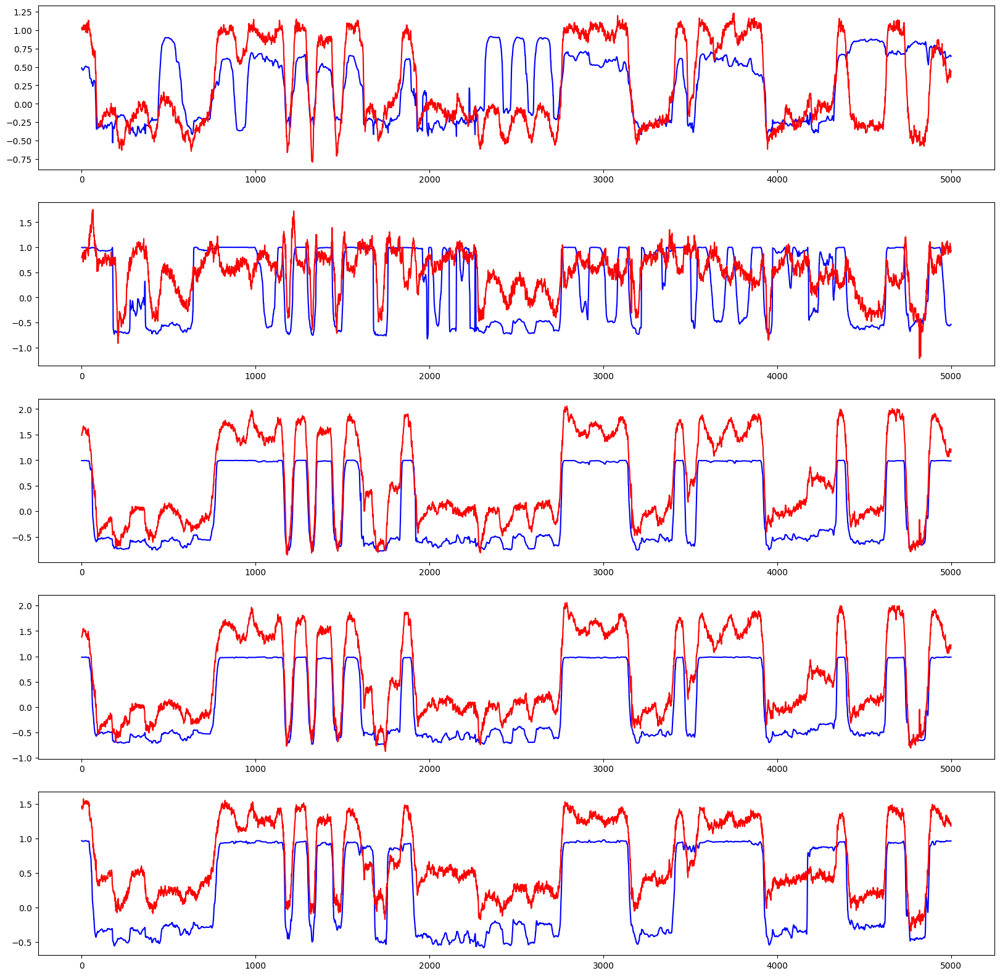

In [26]:
plt.figure(figsize=(5*unit, 5*unit))

get_model_metrics(models_norm, features_test_norm, labels_test)
plt.show()

In [45]:
from sklearn.linear_model import Ridge, Lasso

models_lasso = [None]*5 # List of Linear models with Ridge Regression for each finger in order

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = Lasso(alpha=0.1).fit(features_train_norm, labels_train)
    models_lasso[i] = reg



---Model Metrics for Finger 1---
CoD score: 0.21250322412915823
---Model Metrics for Finger 2---
CoD score: 0.1941164940022837
---Model Metrics for Finger 3---
CoD score: 0.5131486734447976
---Model Metrics for Finger 4---
CoD score: 0.5067631916275264
---Model Metrics for Finger 5---
CoD score: 0.582427083436889


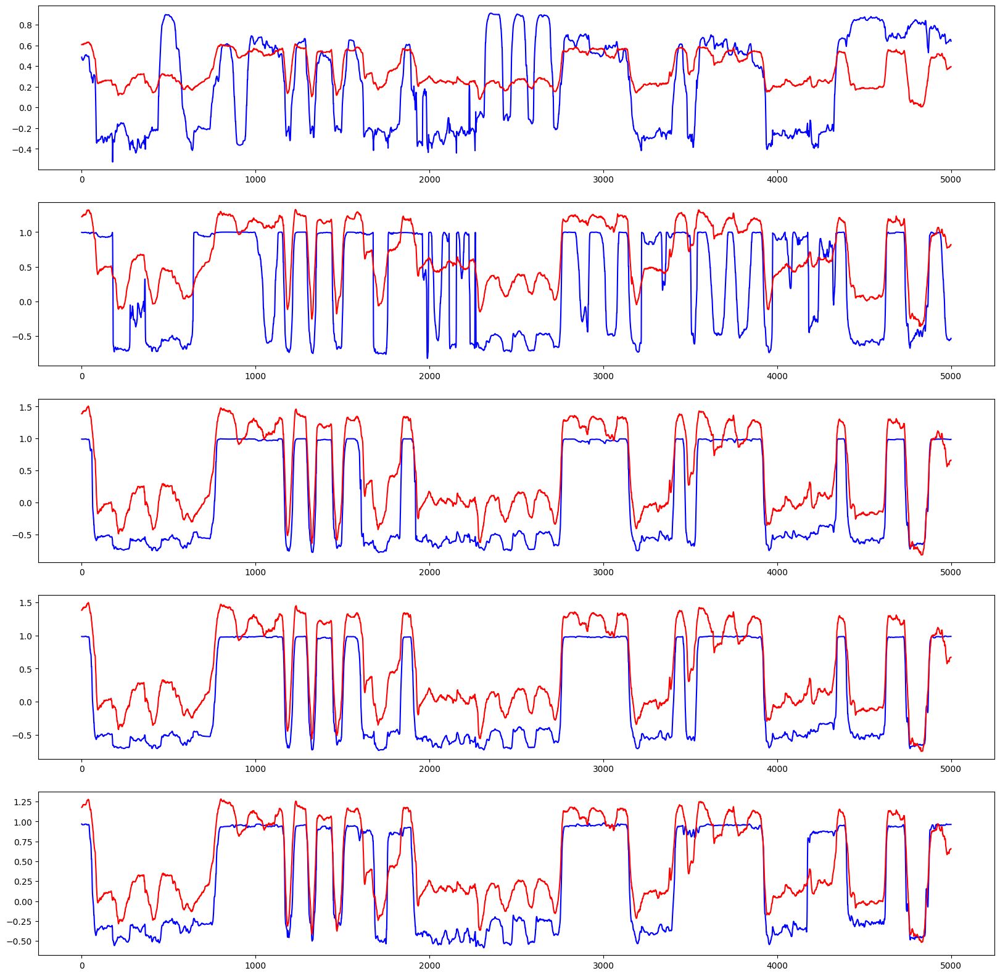

[0.21250322412915823, 0.1941164940022837, 0.5131486734447976, 0.5067631916275264, 0.582427083436889]
0.401791733328131


In [42]:
scores = get_model_metrics(models_lasso, features_test_norm, labels_test)
print(scores)
print(np.average(scores))

Finished Ridge Regression training for alpha 0.0001


c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.383e+03, tolerance: 2.692e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.486e+04, tolerance: 8.324e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6ch

Finished Lasso training for alpha 0.0001
Finished Ridge Regression training for alpha 0.001


c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.723e+03, tolerance: 2.692e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.118e+04, tolerance: 8.324e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6ch

Finished Lasso training for alpha 0.001
Finished Ridge Regression training for alpha 0.01


c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.582e+02, tolerance: 2.692e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.494e+03, tolerance: 8.324e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6ch

Finished Lasso training for alpha 0.01
Finished Ridge Regression training for alpha 0.1
Finished Lasso training for alpha 0.1
Finished Ridge Regression training for alpha 1.0
Finished Lasso training for alpha 1.0
Finished Ridge Regression training for alpha 10.0
Finished Lasso training for alpha 10.0
Finished Ridge Regression training for alpha 100.0
Finished Lasso training for alpha 100.0
Finished Ridge Regression training for alpha 1000.0
Finished Lasso training for alpha 1000.0


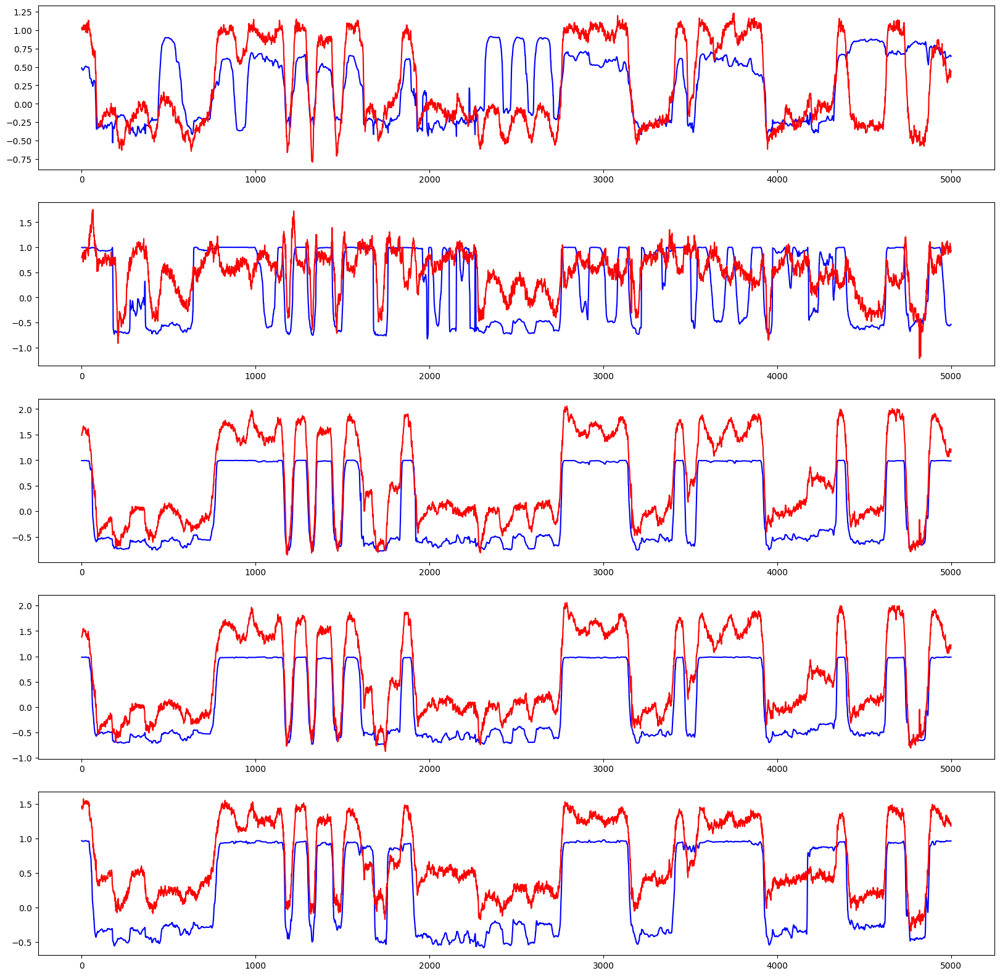

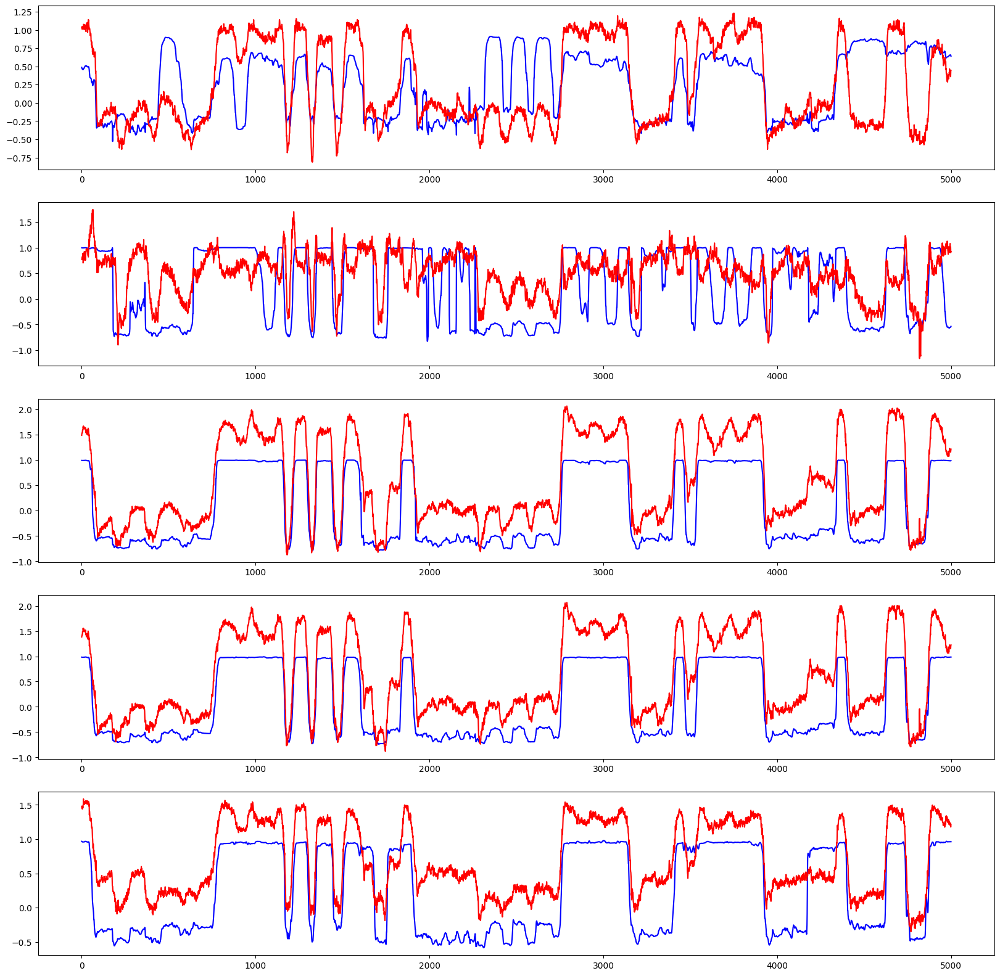

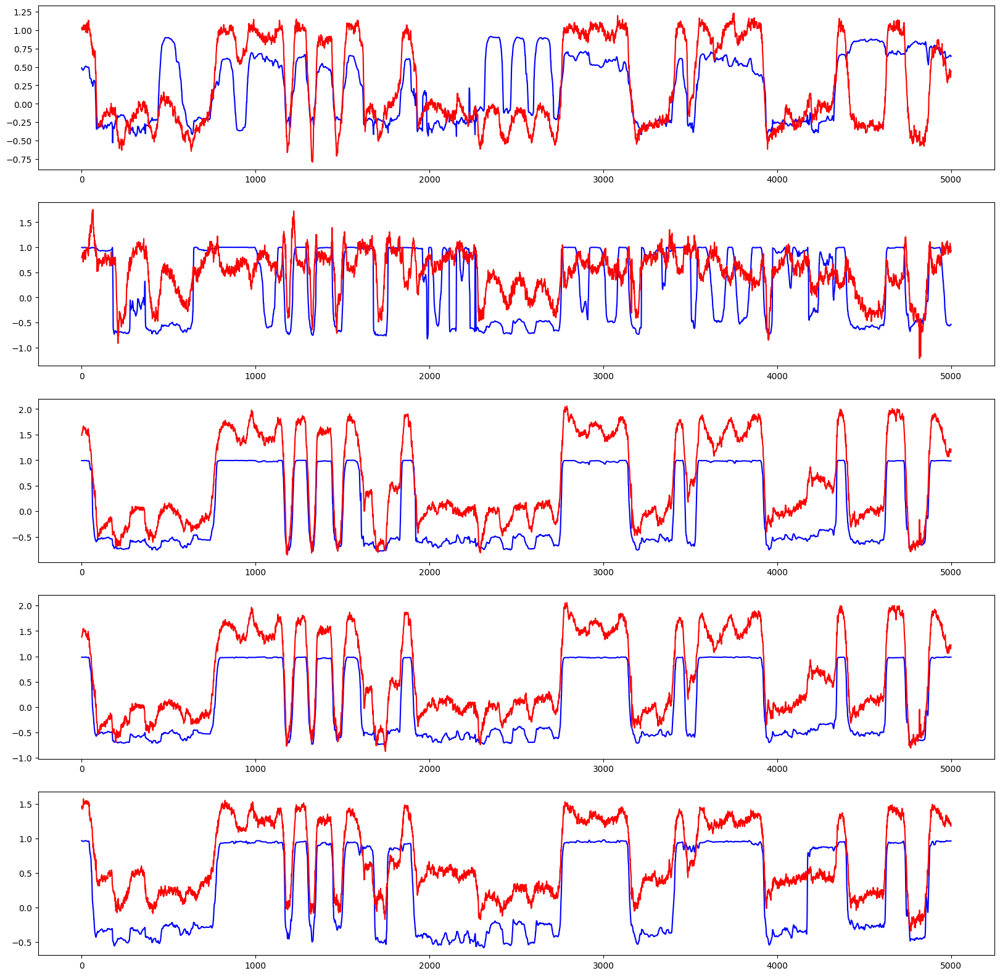

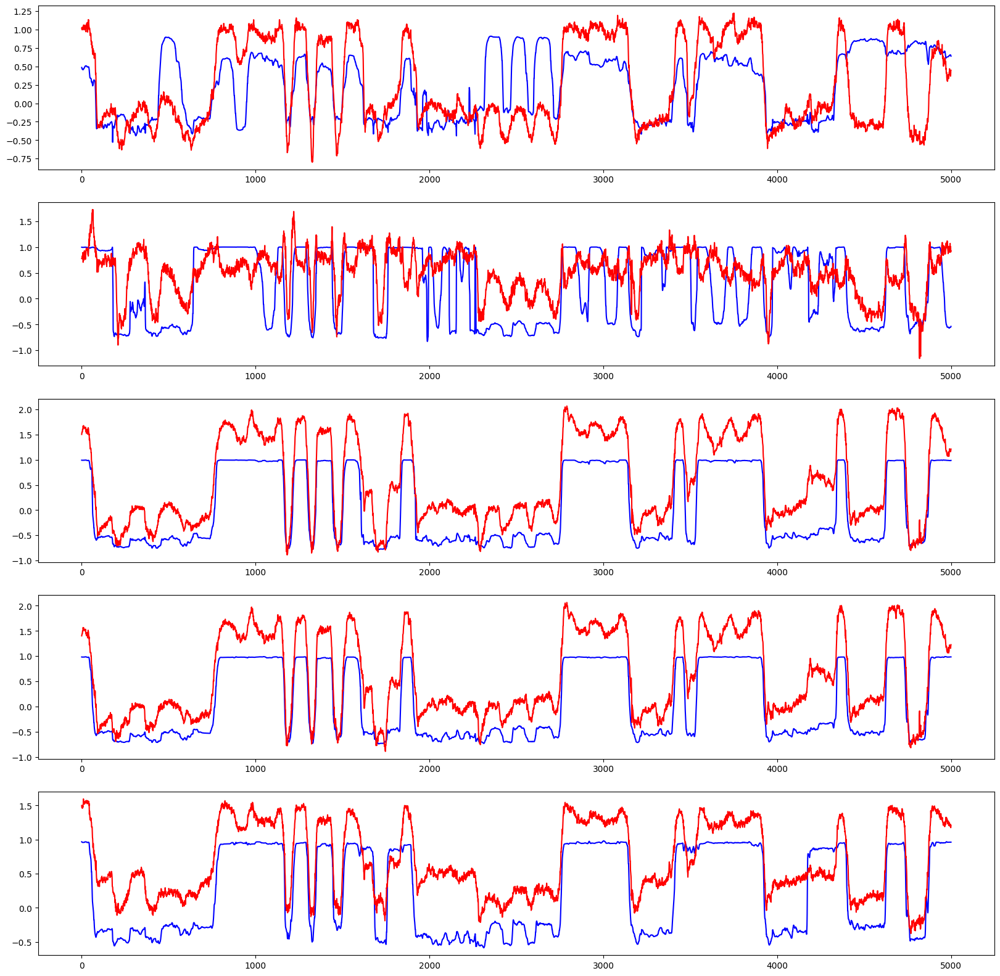

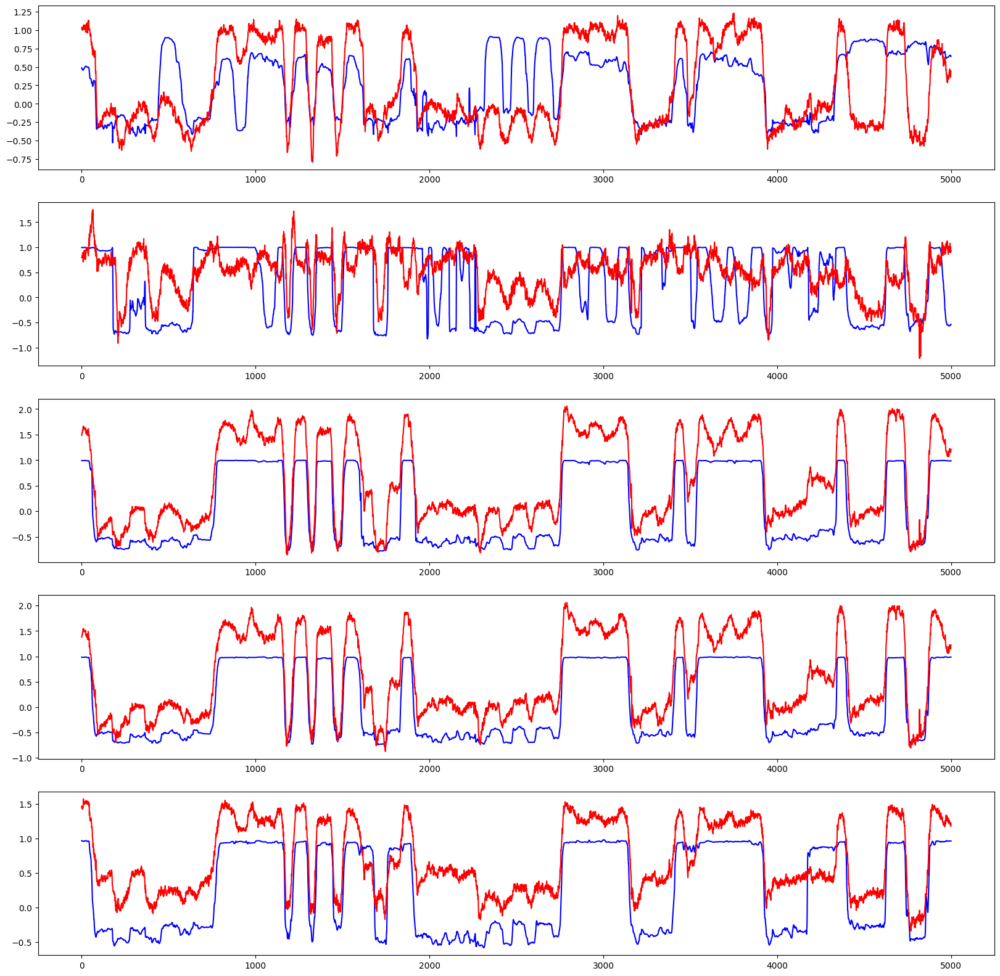

...

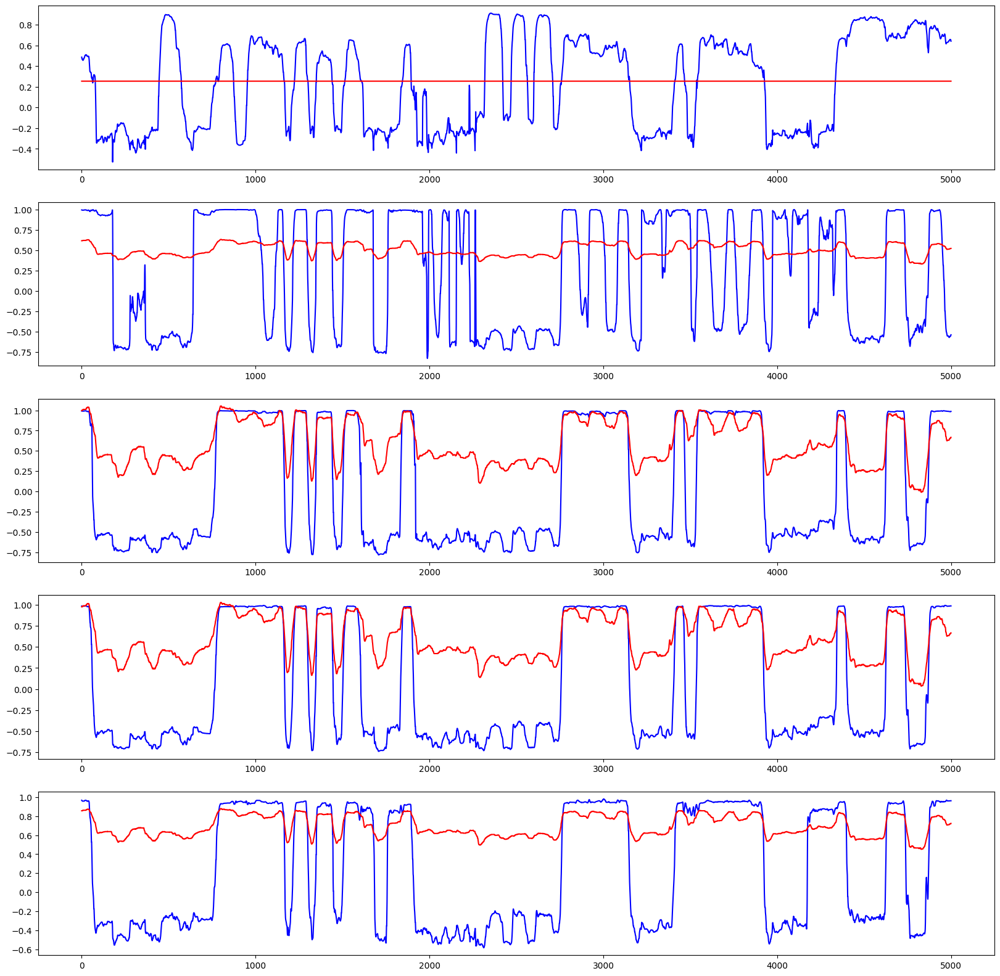

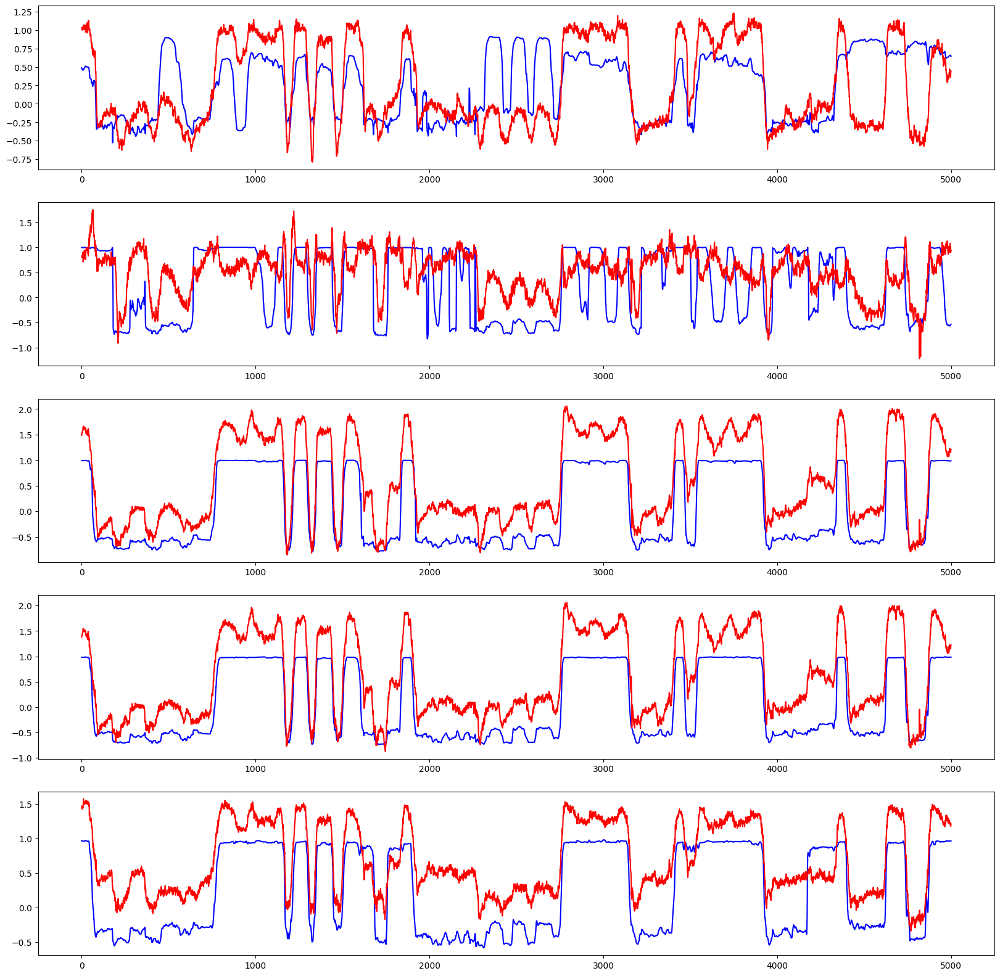

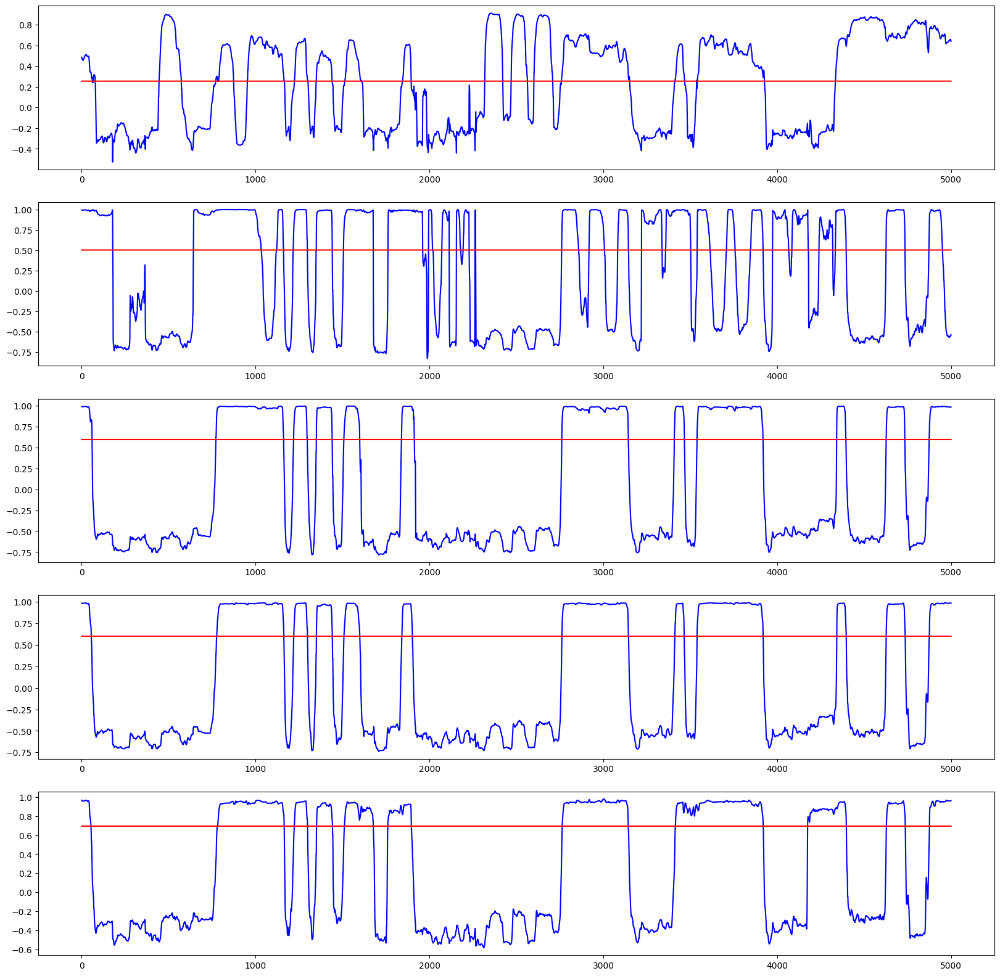

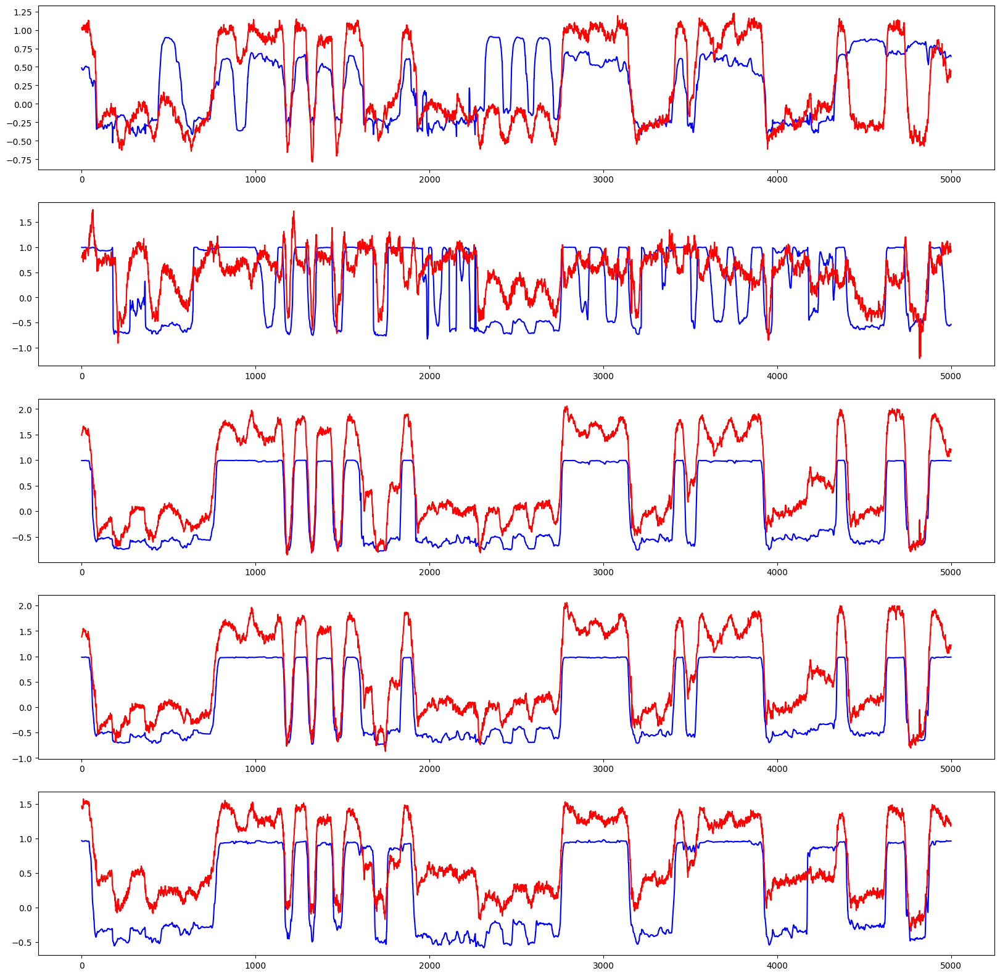

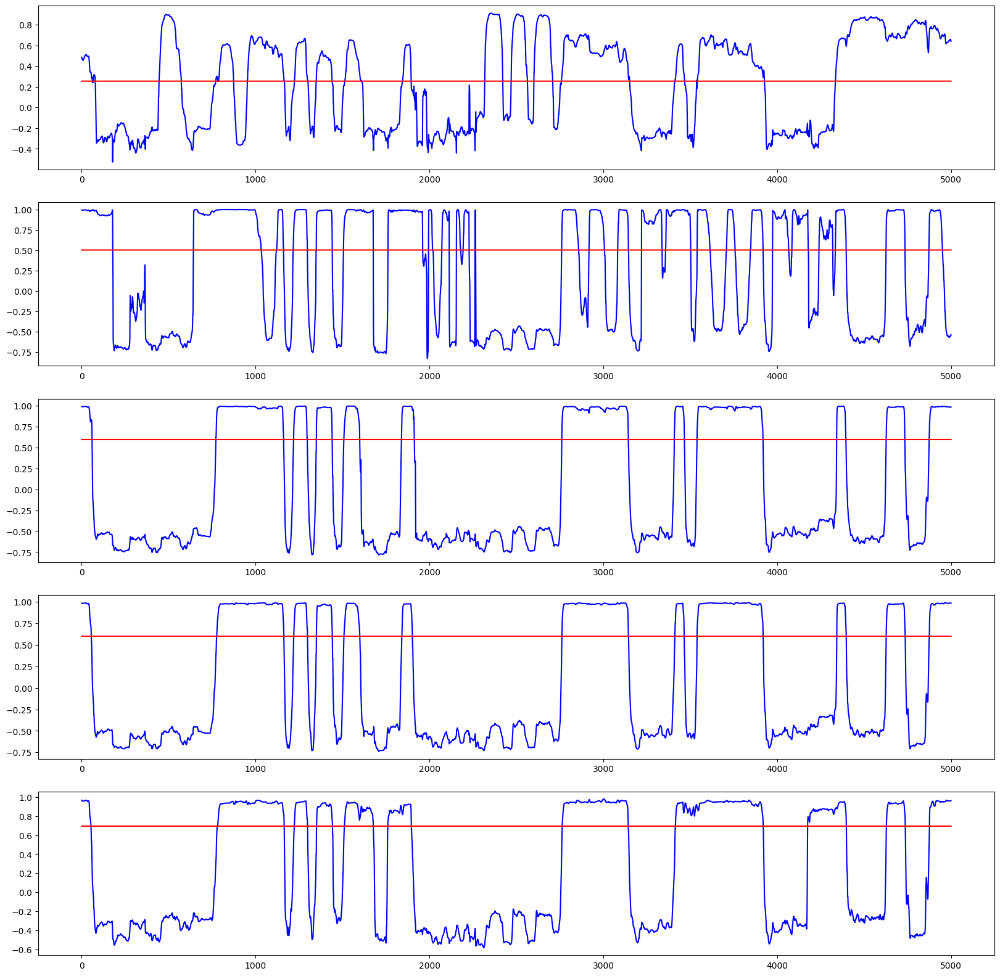

In [43]:
alphas = [1E-4, 1E-3, 1E-2, 1E-1, 1E0, 1E1, 1E2, 1E3]

score_ridge = []  # The average R2 score over the 5 finger, indices match that of the alphas list
score_lasso = []

def get_model_accuracy(model, alpha, features_train, labels, features_test, labels_test):
    models = [None]*5  # Trained linear models

    for i in range(5):
        labels_train = np.vstack(labels[:40])[:,i]
        reg = model(alpha=alpha).fit(features_train, labels_train)
        models[i] = reg
        
    scores = get_model_metrics(models, features_test, labels_test, print_graph=False)
    return np.average(scores)

for a in alphas:
    score_ridge.append(get_model_accuracy(Ridge, a, features_train_norm, labels, features_test_norm, labels_test))
    print(f'Finished Ridge Regression training for alpha {a}')
    score_lasso.append(get_model_accuracy(Lasso, a, features_train_norm, labels, features_test_norm, labels_test))
    print(f'Finished Lasso training for alpha {a}')



In [44]:
print(score_ridge)  # For Ridge the performance is similar for all alpha,so pick alpha=1
print(score_lasso)  # For Lasso the performance is best for alpha=-1

[0.3739628905245851, 0.37396289133970556, 0.37396289949091865, 0.37396298100293024, 0.3739637961148949, 0.37397194639682707, 0.3740533655588705, 0.3748592880148232]
[0.37514332754784424, 0.38290918706612764, 0.4257354303067135, 0.4449018134832715, 0.32427664778858356, 0.05746575809845087, -0.23520239021277956, -0.23520239021277956]


## Polynomial Basis Expansion
If the constraint isn't in the data, perhaps we can try bigger models?

In [23]:
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(2, include_bias=False)

features_train_poly = poly.fit_transform(features_train)
features_test_poly = poly.fit_transform(features_test)

In [52]:
models_poly_linear = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_poly, labels_train)
    models_poly_linear[i] = reg

---Model Metrics for Finger 1---
CoD score: -10.10285085766051
---Model Metrics for Finger 2---
CoD score: -6.174249100368242
---Model Metrics for Finger 3---
CoD score: -3.06727264561247
---Model Metrics for Finger 4---
CoD score: -3.9699909511444336
---Model Metrics for Finger 5---
CoD score: -2.1626005514102324


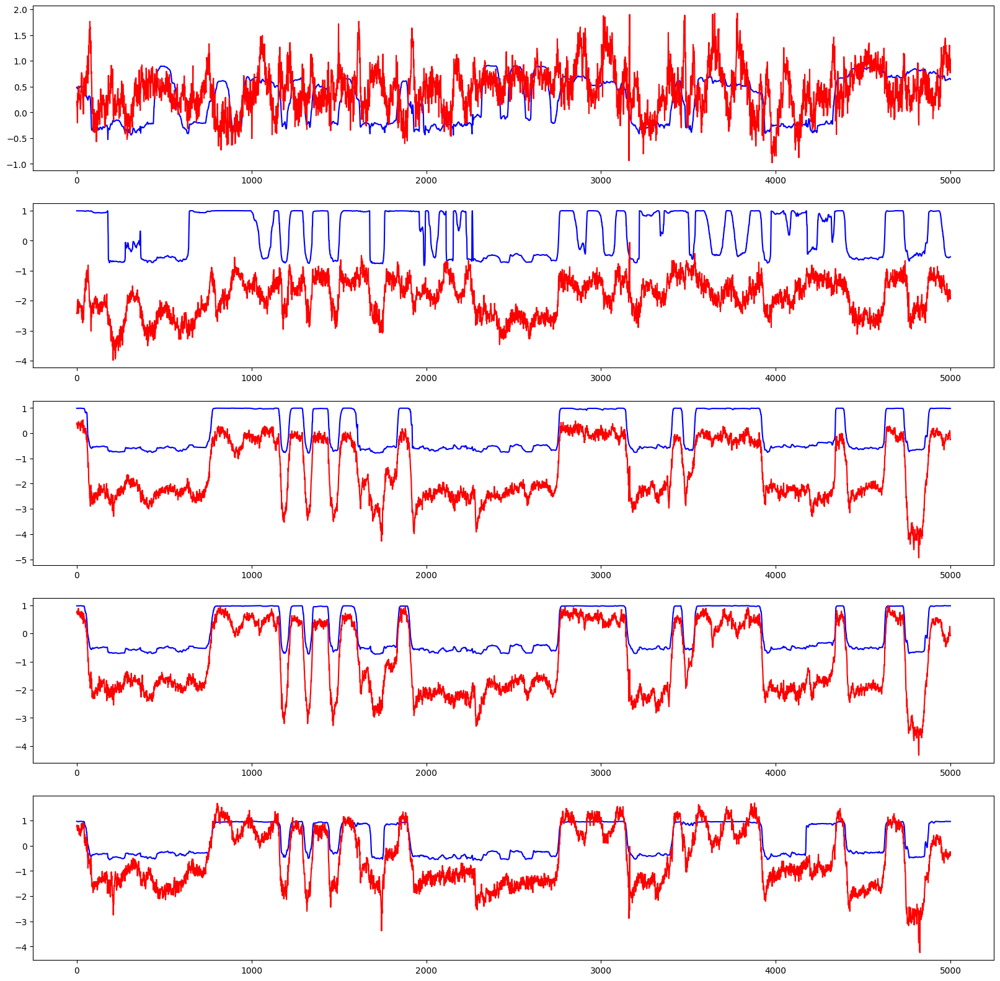

[-10.10285085766051,
 -6.174249100368242,
 -3.06727264561247,
 -3.9699909511444336,
 -2.1626005514102324]

In [55]:
get_model_metrics(models_poly_linear, features_test_poly, labels_test)

In [24]:
features_train_poly_norm = poly.fit_transform(features_train_norm)
features_test_poly_norm = poly.fit_transform(features_test_norm)

In [25]:
models_poly_linear_centered = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_poly_norm, labels_train)
    models_poly_linear_centered[i] = reg

---Model Metrics for Finger 1---
CoD score: -0.0561044168675191
---Model Metrics for Finger 2---
CoD score: -0.3035025452735658
---Model Metrics for Finger 3---
CoD score: 0.19416292645838518
---Model Metrics for Finger 4---
CoD score: 0.004104121203499345
---Model Metrics for Finger 5---
CoD score: -0.05406534736534363


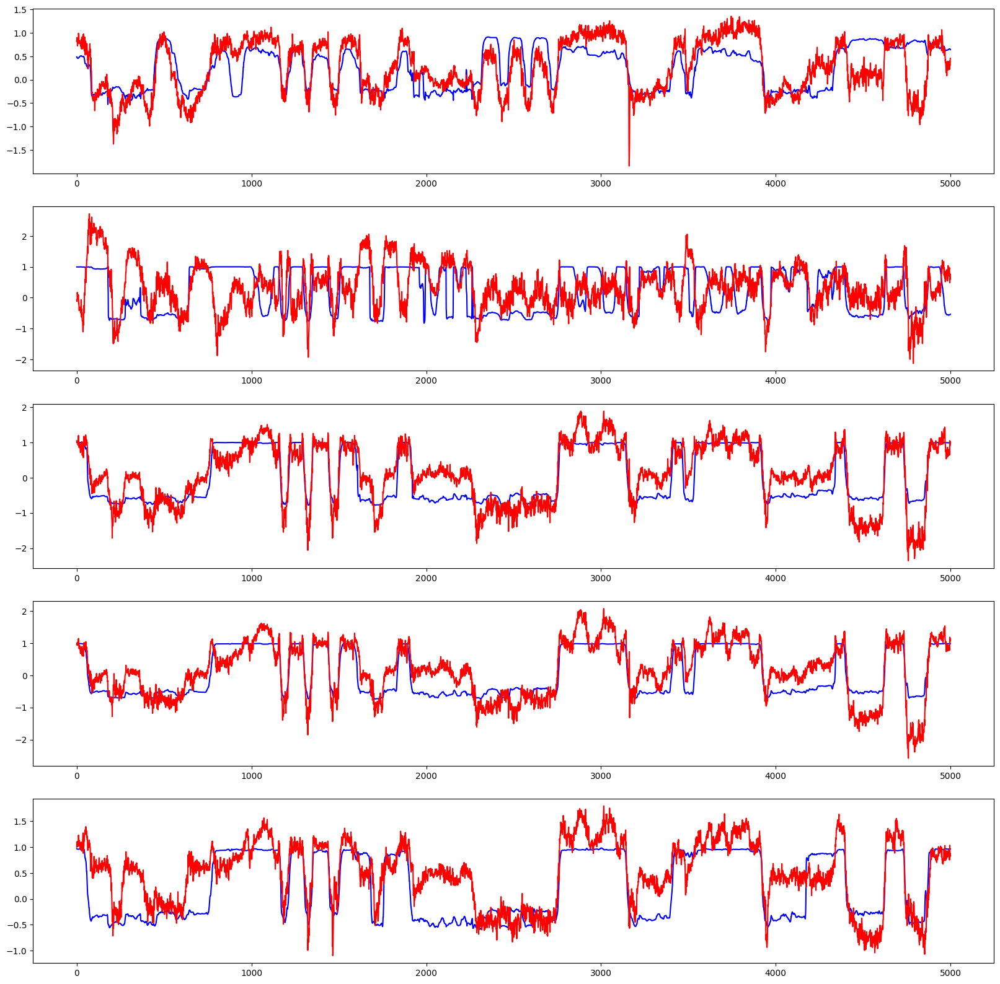

[-0.0561044168675191,
 -0.3035025452735658,
 0.19416292645838518,
 0.004104121203499345,
 -0.05406534736534363]

In [26]:
get_model_metrics(models_poly_linear_centered, features_test_poly_norm, labels_test)

In [28]:
from sklearn.linear_model import Lasso

models_lasso_poly = [None]*5 # List of Linear models with Ridge Regression for each finger in order

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = Lasso(alpha=0.1).fit(features_train_poly_norm, labels_train)
    models_lasso_poly[i] = reg

c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.588e+03, tolerance: 2.692e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6challenge\port6challenge\.venv\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.349e+03, tolerance: 8.324e+00
  model = cd_fast.enet_coordinate_descent(
c:\Users\zaiyu\Linux\Documents\Career\Company Profiles\2023\Port6 - Embedded ML Engineer\port6ch

---Model Metrics for Finger 1---
CoD score: 0.3181681994834006
---Model Metrics for Finger 2---
CoD score: 0.14032708339672317
---Model Metrics for Finger 3---
CoD score: 0.458420766246907
---Model Metrics for Finger 4---
CoD score: 0.4762958183675696
---Model Metrics for Finger 5---
CoD score: 0.34901124354738455


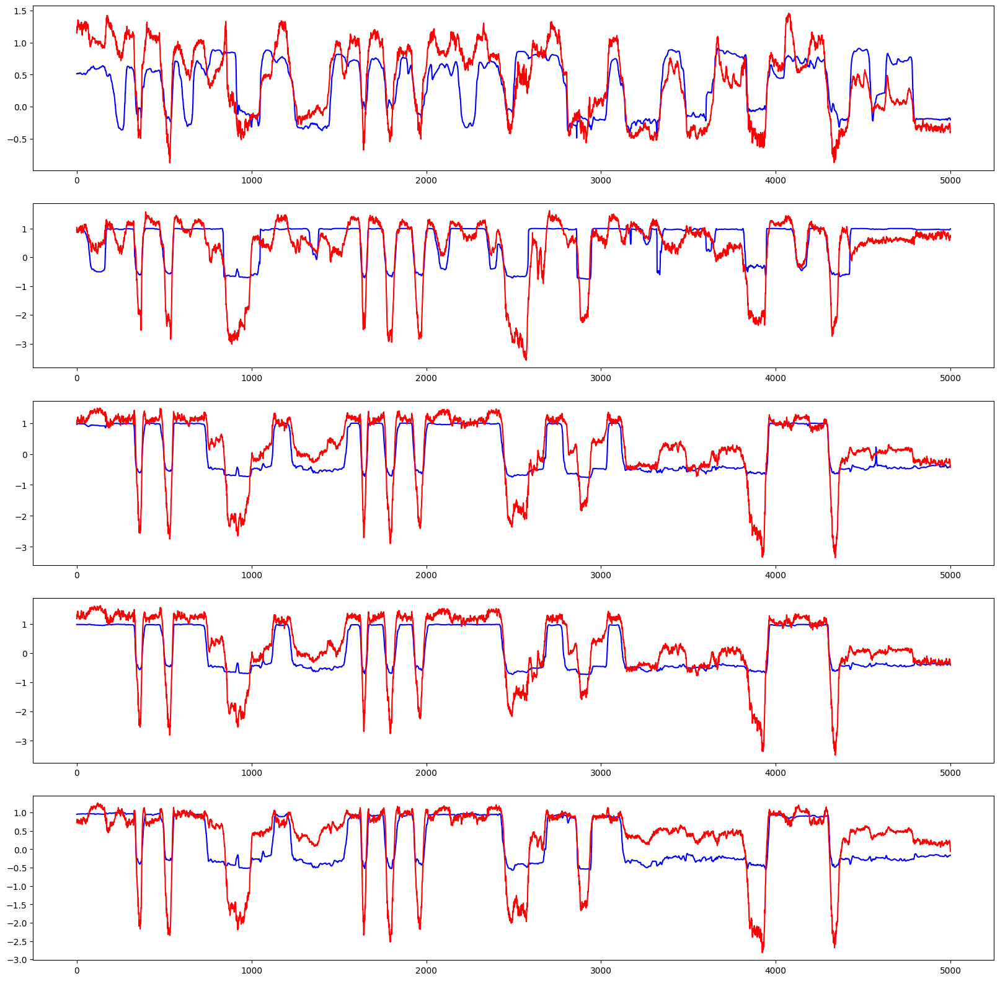

[0.3181681994834006,
 0.14032708339672317,
 0.458420766246907,
 0.4762958183675696,
 0.34901124354738455]

In [30]:
get_model_metrics(models_lasso_poly, features_test_poly_norm, labels_test, offset=10000)

## K Nearest Neighbours
A simple KNN approach to make use of the volume of data we have

In [36]:
from sklearn.neighbors import KNeighborsRegressor

models_knn = [None]*5 # List of Linear models with Ridge Regression for each finger in order

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = KNeighborsRegressor(n_neighbors=10).fit(features_train_norm, labels_train)
    models_knn[i] = reg


In [39]:
get_model_metrics(models_knn, features_test_norm, labels_test)

KeyboardInterrupt: 

---Model Metrics for Finger 1---
CoD score: 0.21036728680106165
---Model Metrics for Finger 2---
CoD score: 0.3419754628621947
---Model Metrics for Finger 3---
CoD score: 0.577116683387604
---Model Metrics for Finger 4---
CoD score: 0.6926665810160332
---Model Metrics for Finger 5---
CoD score: 0.45487317794212445


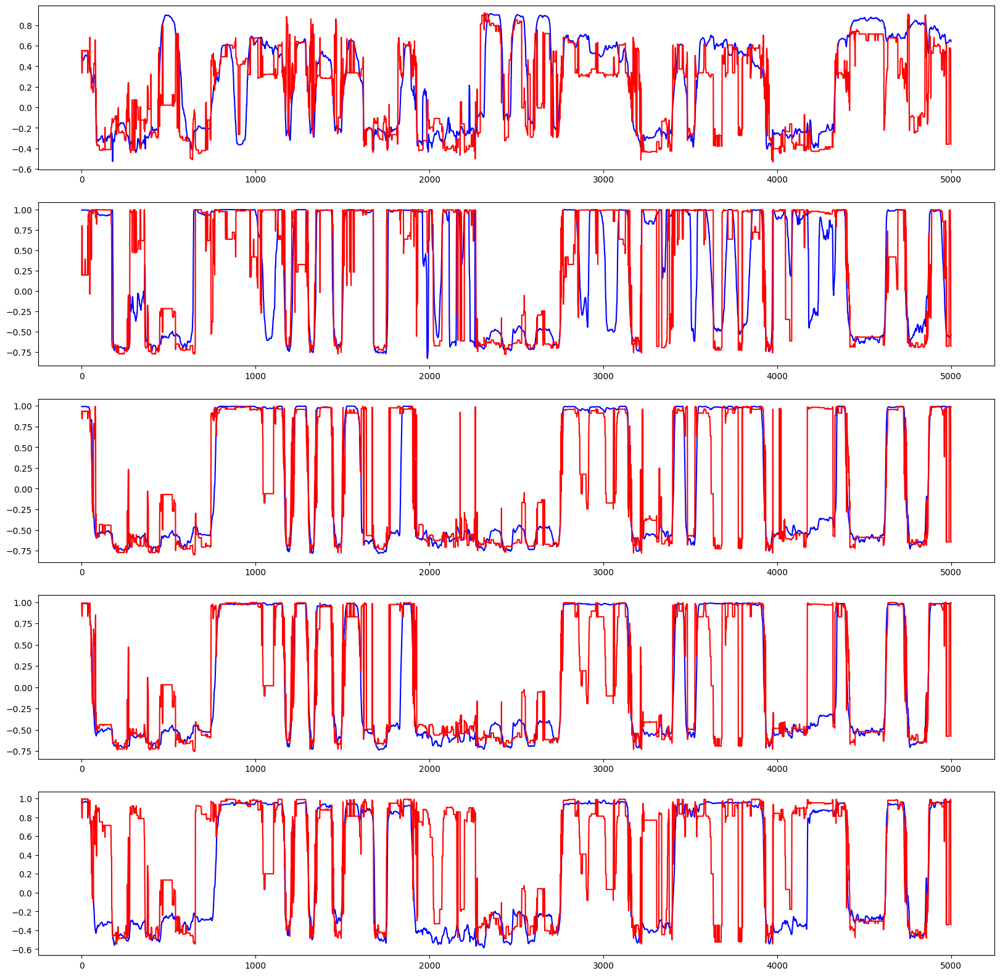

Model training and validation complete for k value 1
---Model Metrics for Finger 1---
CoD score: 0.2439841836485881
---Model Metrics for Finger 2---
CoD score: 0.3805940802670199
---Model Metrics for Finger 3---
CoD score: 0.5980999479266718
---Model Metrics for Finger 4---
CoD score: 0.7073247938031102
---Model Metrics for Finger 5---
CoD score: 0.47543321888125833


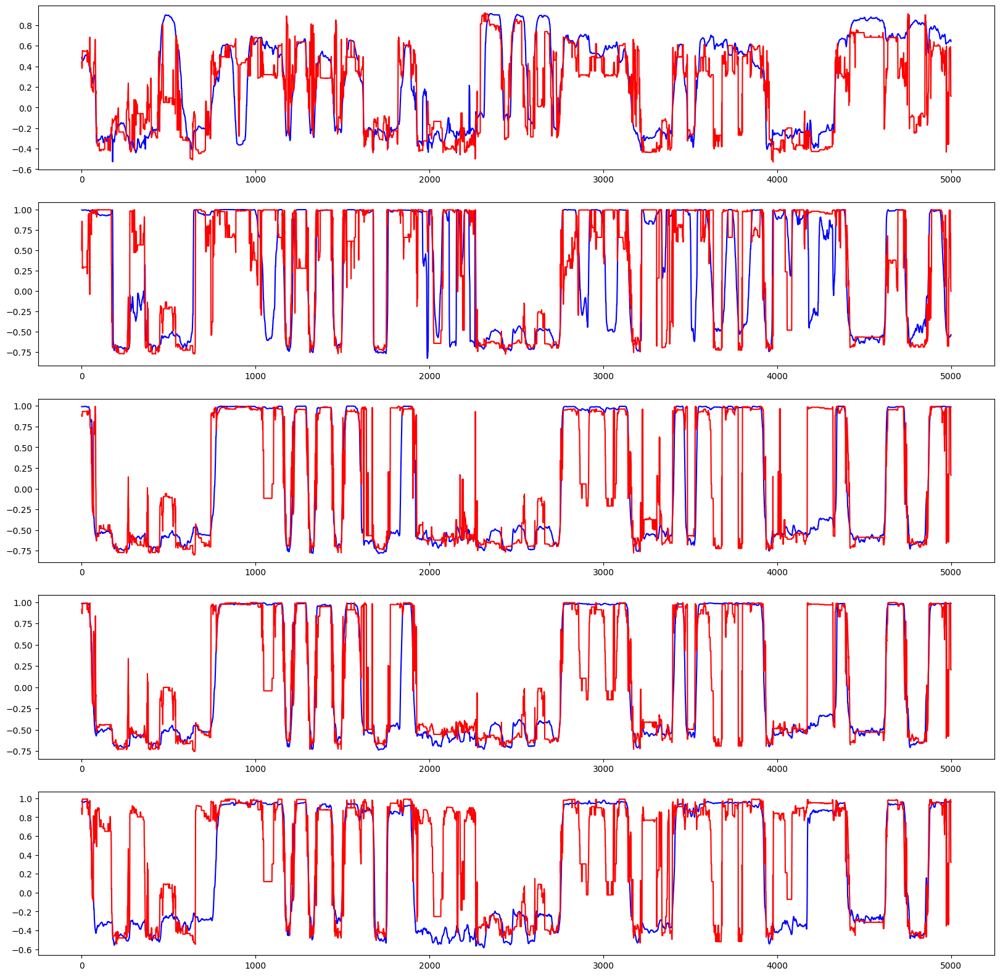

Model training and validation complete for k value 2
---Model Metrics for Finger 1---
CoD score: 0.28791386992347334
---Model Metrics for Finger 2---
CoD score: 0.40892033652175175
---Model Metrics for Finger 3---
CoD score: 0.6201072855016998
---Model Metrics for Finger 4---
CoD score: 0.7234331043314177
---Model Metrics for Finger 5---
CoD score: 0.48683611798117776


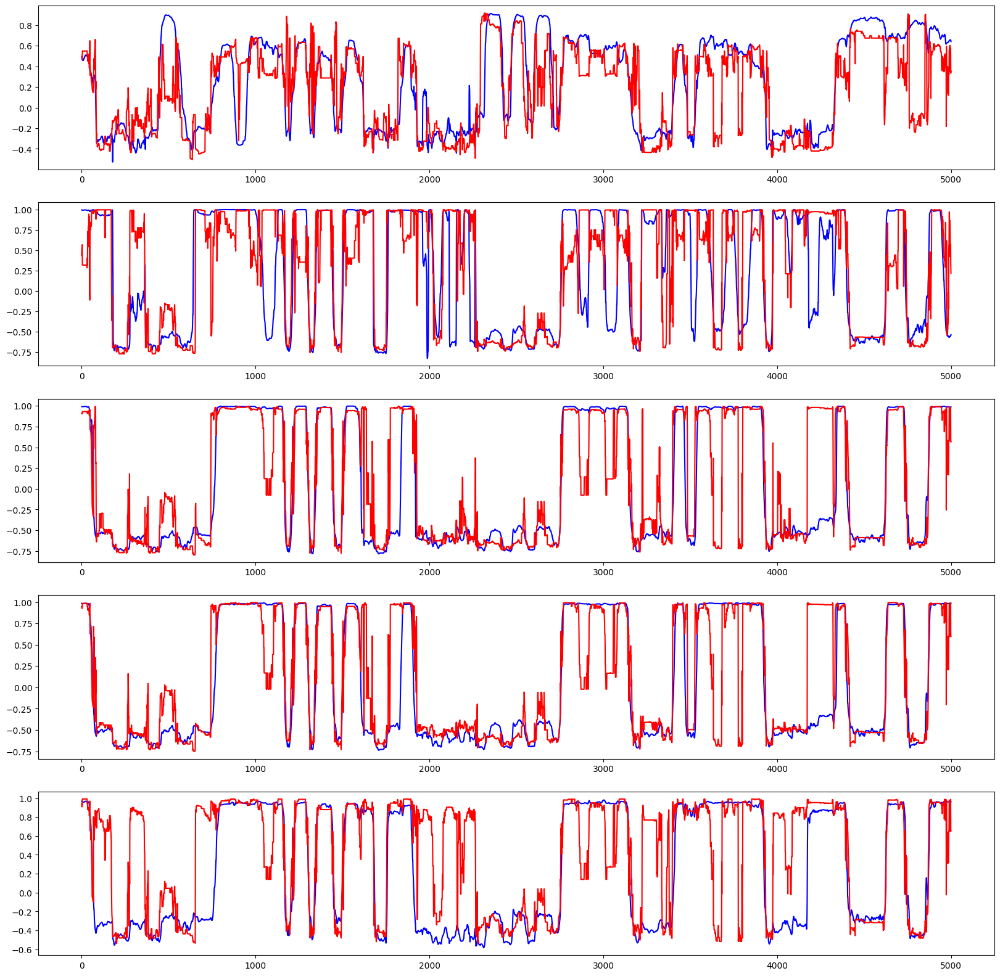

Model training and validation complete for k value 4
---Model Metrics for Finger 1---
CoD score: 0.33854868655760884
---Model Metrics for Finger 2---
CoD score: 0.43012816764890505
---Model Metrics for Finger 3---
CoD score: 0.639714436014136
---Model Metrics for Finger 4---
CoD score: 0.7355057612207605
---Model Metrics for Finger 5---
CoD score: 0.49252404838726993


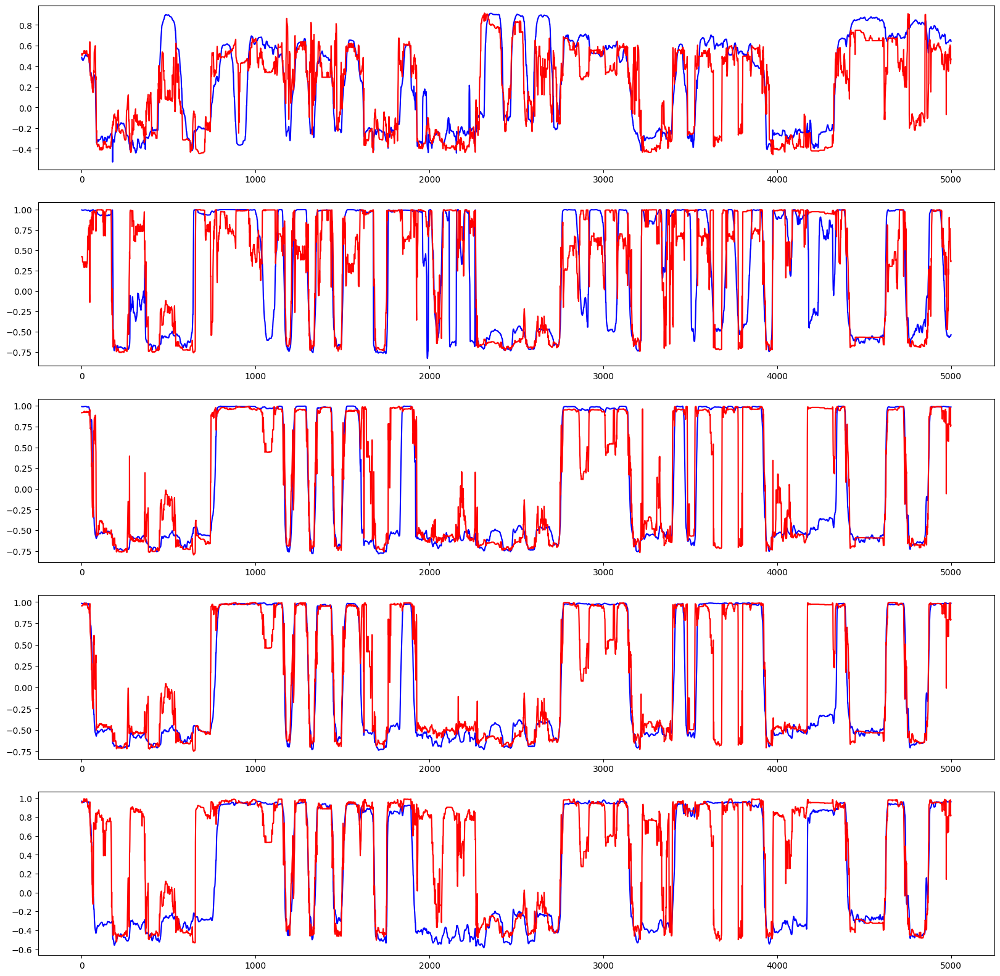

Model training and validation complete for k value 8
---Model Metrics for Finger 1---
CoD score: 0.395892208959002
---Model Metrics for Finger 2---
CoD score: 0.4437748801932614
---Model Metrics for Finger 3---
CoD score: 0.6582591866123333
---Model Metrics for Finger 4---
CoD score: 0.7440767457118102
---Model Metrics for Finger 5---
CoD score: 0.4885611506025459


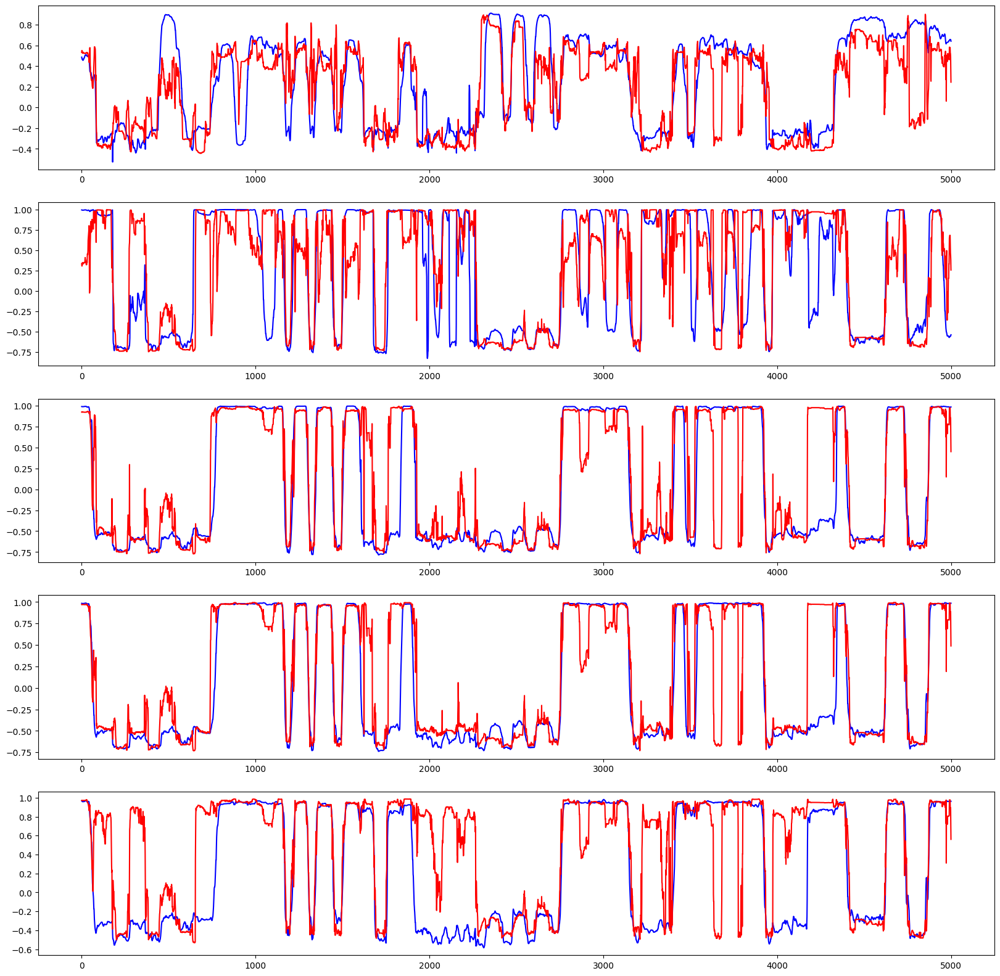

Model training and validation complete for k value 16
---Model Metrics for Finger 1---
CoD score: 0.44976385833953036
---Model Metrics for Finger 2---
CoD score: 0.45000335688162085
---Model Metrics for Finger 3---
CoD score: 0.67981144085977
---Model Metrics for Finger 4---
CoD score: 0.7497105229414902
---Model Metrics for Finger 5---
CoD score: 0.48896065653664456


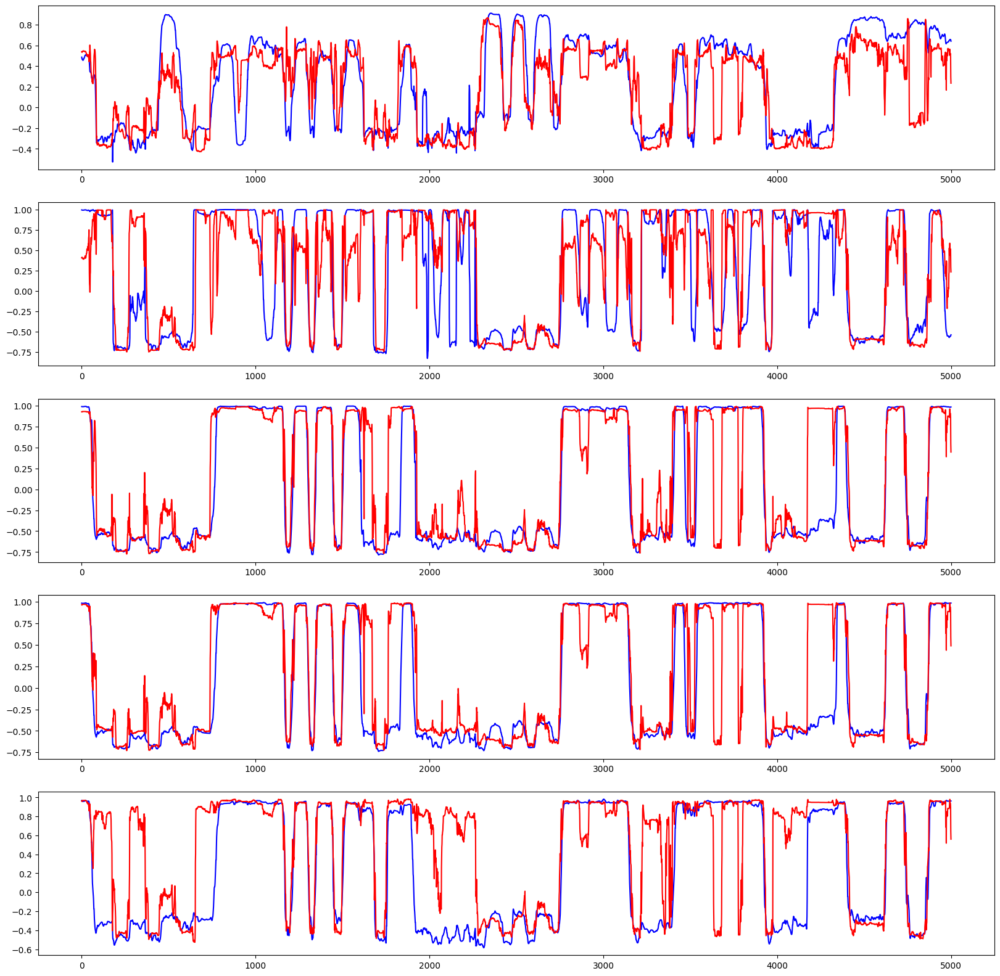

Model training and validation complete for k value 32
---Model Metrics for Finger 1---
CoD score: 0.4787963091437202
---Model Metrics for Finger 2---
CoD score: 0.4562276970632142
---Model Metrics for Finger 3---
CoD score: 0.7050286216275041
---Model Metrics for Finger 4---
CoD score: 0.7549996735304396
---Model Metrics for Finger 5---
CoD score: 0.49125453153419574


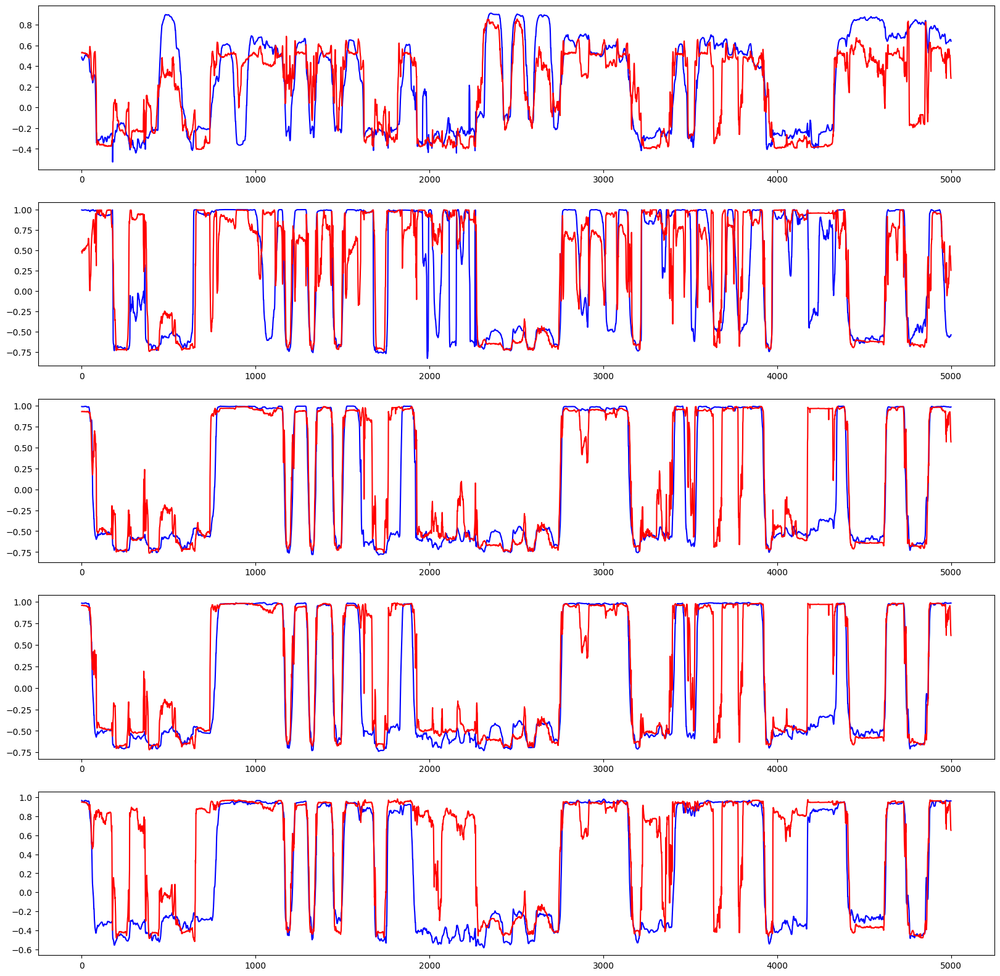

Model training and validation complete for k value 64


In [45]:
ks = [1,2,4,8,16,32,64]
scores_knn = []  # Average R2 loss over the 5 fingers
for i in range(len(ks)):
    models_knn = [None]*5
    for j in range(5):
        labels_train = np.vstack(labels[:40])[:,j]
        reg = KNeighborsRegressor(n_neighbors=ks[i]).fit(features_train_norm, labels_train)
        models_knn[j] = reg
    score = get_model_metrics(models_knn, features_test_norm, labels_test)
    scores_knn.append(np.average(score))
    print(f'Model training and validation complete for k value {ks[i]}')

## Neural Networks
Let's try a simple 2 layer NN

architecture: input -> fully connected -> ReLU -> fully connected

size: 30 -> 70 -> 5

In [57]:
labels_train = np.vstack(labels[:40])
labels_test = np.vstack(labels[40:])

In [100]:
ITERATIONS = 2000

device = torch.device('cpu')
# device = torch.device('cuda')

# N is batch size; D_in is input dimension;
# H is hidden dimension; D_out is output dimension.
N, D_in, H, D_out = features_train_norm.shape[0], 30, 70, 5

# Create random Tensors to hold inputs and outputs
x = torch.tensor(features_train_norm, dtype=torch.float32)
y = torch.tensor(labels_train, dtype=torch.float32)
assert x.shape == (N, D_in), f'x expected to have shape {(N, D_in)} but got shape {x.shape}'
assert y.shape == (N, D_out), f'y expected to have shape {(N, D_out)} but got shape {y.shape}'
print(f'Dimension of input: {x.shape}')
print(f'Dimension of output: {y.shape}')

model = torch.nn.Sequential(
          torch.nn.Linear(D_in, H),
          torch.nn.ReLU(),
          torch.nn.Linear(H, D_out),
        ).to(device)

loss_fn = torch.nn.MSELoss(reduction='mean')

optimizer = torch.optim.Adam(params=model.parameters(), lr=1E-4, weight_decay=1E-5)

losses_train = []
losses_test = []

learning_rate = 1e-4
for t in range(ITERATIONS):
    y_pred = model(x)

    loss = loss_fn(y_pred, y)
    if t%100 == 99:
        print(t, loss.item())
        losses_train.append(loss.item())
        loss_test = loss_fn(model(torch.tensor(features_test_norm, dtype=torch.float32)), torch.tensor(labels_test, dtype=torch.float32))
        print(t, loss_test.item())
        losses_test.append(loss_test.item())

    # Zero the gradients before running the backward pass.
    model.zero_grad()

    # Backward pass: compute gradient of the loss with respect to all the learnable
    # parameters of the model. Internally, the parameters of each Module are stored
    # in Tensors with requires_grad=True, so this call will compute gradients for
    # all learnable parameters in the model.
    loss.backward()

    optimizer.step()

Dimension of input: torch.Size([199649, 30])
Dimension of output: torch.Size([199649, 5])
99 0.8790014386177063
99 2.3544795513153076
199 0.5206406116485596
199 1.5573794841766357
299 0.3754940629005432
299 1.2098838090896606
399 0.30520835518836975
399 1.0304452180862427
499 0.26408952474594116
499 0.9305170178413391
599 0.23703035712242126
599 0.8573576807975769
699 0.2174137532711029
699 0.7990233898162842
799 0.20195800065994263
799 0.7497258186340332
899 0.1891034096479416
899 0.7060765624046326
999 0.17816559970378876
999 0.667693555355072
1099 0.1687677502632141
1099 0.6342845559120178
1199 0.16058392822742462
1199 0.6049657464027405
1299 0.15339472889900208
1299 0.5791935324668884
1399 0.1470092535018921
1399 0.5560886859893799
1499 0.1412716507911682
1499 0.5352889895439148
1599 0.1360555738210678
1599 0.516448438167572
1699 0.13126148283481598
1699 0.4990868866443634
1799 0.12681259214878082
1799 0.4830971658229828
1899 0.12264162302017212
1899 0.46815261244773865
1999 0.1187

In [ ]:
import matplotlib.pyplot as plt

take = 10

N = len(labels[take])
x = list(range(N))
y = labels[take][:,2] # Thumb

fig, ax = plt.subplots()
ax.plot(x,y)
plt.show()

In [101]:
def get_model_metrics_full(model, features_test, labels_test, offset=0, use_capping=False, print_graph=True, full_model=False):
    '''
    Get the score for a full model (model outputs all 5 points together)
    '''
    plt.figure(figsize=(5*unit, 5*unit))

    scores = []

    preds = None
    if use_capping:
        preds = list(map(lambda x: cap(x, -1, 1), model(features_test)))
    else:
        preds = model(torch.tensor(features_test, dtype=torch.float32))

    scores = r2_score(labels_test, preds.detach().numpy(), multioutput='raw_values')

    for i in range(5):
        if print_graph:
            print(f'---Model Metrics for Finger {i+1}---')

        if print_graph:
            print(f"CoD score: {r2_score(labels_test[:,i], preds[:,i].detach().numpy())}")
        # print(f"Coefficients: \n{reg.coef_}")
        # print(f"Bias: {reg.intercept_}")

        show_length = 5000
        y = labels_test[offset:offset+show_length,i]
        plt.subplot(5, 1, i+1)
        plt.plot(list(range(show_length)), y, 'b', list(range(show_length)), preds[offset:offset+show_length,i].detach().numpy(), 'r')

    if print_graph:
        plt.show()

    return scores


---Model Metrics for Finger 1---
CoD score: -0.582969895361974
---Model Metrics for Finger 2---
CoD score: 0.044566046844120466
---Model Metrics for Finger 3---
CoD score: 0.40817590216956867
---Model Metrics for Finger 4---
CoD score: -0.005747577876783039
---Model Metrics for Finger 5---
CoD score: -0.6719632346218283


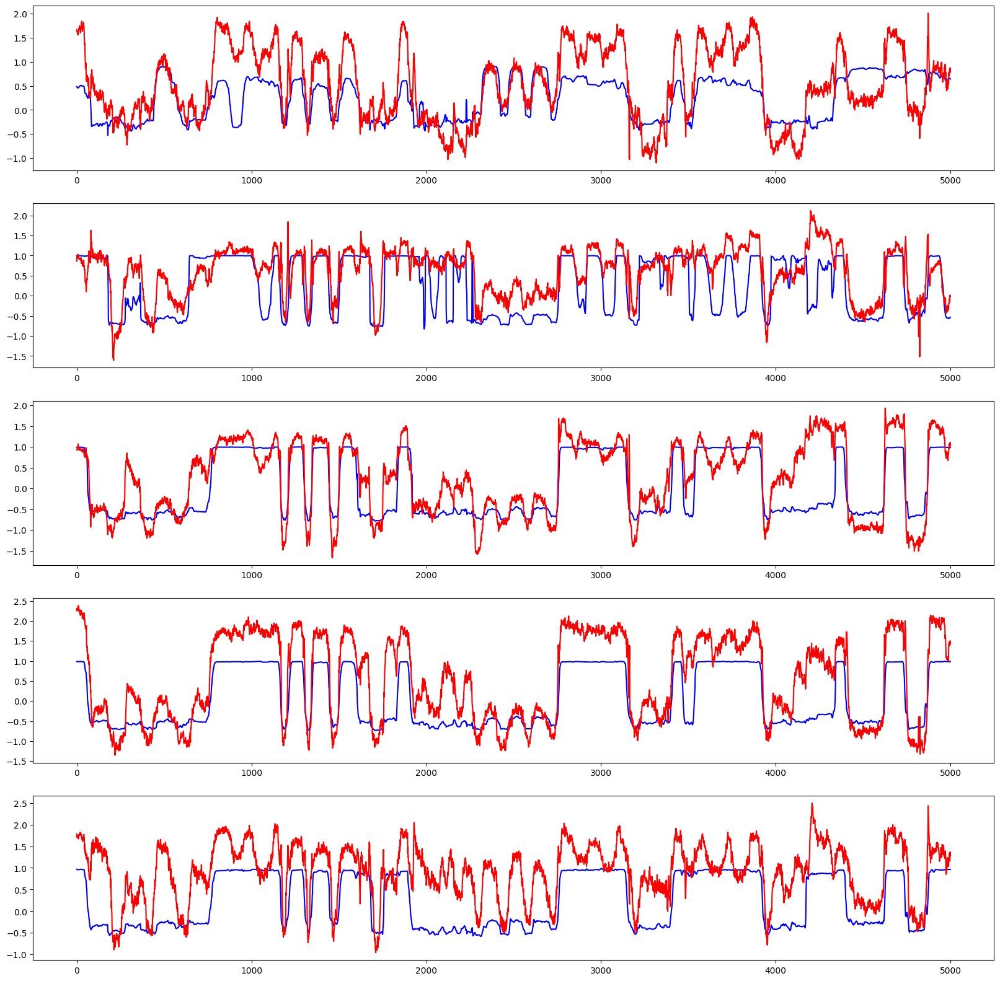

array([-0.5829699 ,  0.04456605,  0.4081759 , -0.00574758, -0.67196323])

In [102]:
get_model_metrics_full(model, features_test_norm, labels_test)

In [121]:
print(features_train.shape)
print(labels_train.shape)

(199649, 30)
(199649, 5)


## Principal Component Analysis
There is a lot of correlation between the dimensions of the input data. It may be a good idea to first treat the data with PCA to reduce dimension, in hopes of removing noise.

In [125]:
from sklearn.decomposition import PCA

pca = PCA(n_components=30)
pca.fit(features_train)

PCA(n_components=30)

[8.69121246e-01 7.74441123e-02 1.80268725e-02 1.14900464e-02
 7.24989690e-03 5.78523378e-03 3.48746105e-03 2.13598611e-03
 1.39012701e-03 9.10575861e-04 6.38145093e-04 5.29559761e-04
 3.87201672e-04 2.68502269e-04 2.27048890e-04 2.02272998e-04
 1.25910949e-04 1.18898290e-04 1.09485504e-04 7.56973418e-05
 5.54757365e-05 4.33547058e-05 3.52964897e-05 2.93068224e-05
 2.73692919e-05 2.58203492e-05 1.94847200e-05 1.66913368e-05
 1.25256136e-05 1.03942308e-05]


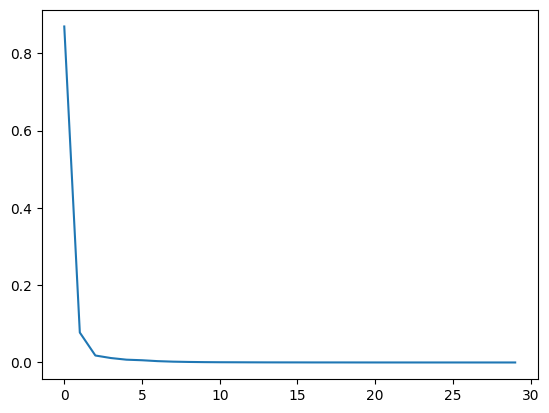

In [127]:
print(pca.explained_variance_ratio_)

x = list(range(30))
y = pca.explained_variance_ratio_

fig, ax = plt.subplots()
ax.plot(x,y)
plt.show()

# From the graph is seems like `n_components=3` captures most variance in data

In [129]:
print(features_full.shape)

pca = PCA(n_components=3)
features_full_pca = pca.fit_transform(features_full)

(254649, 30)


(254649, 3)


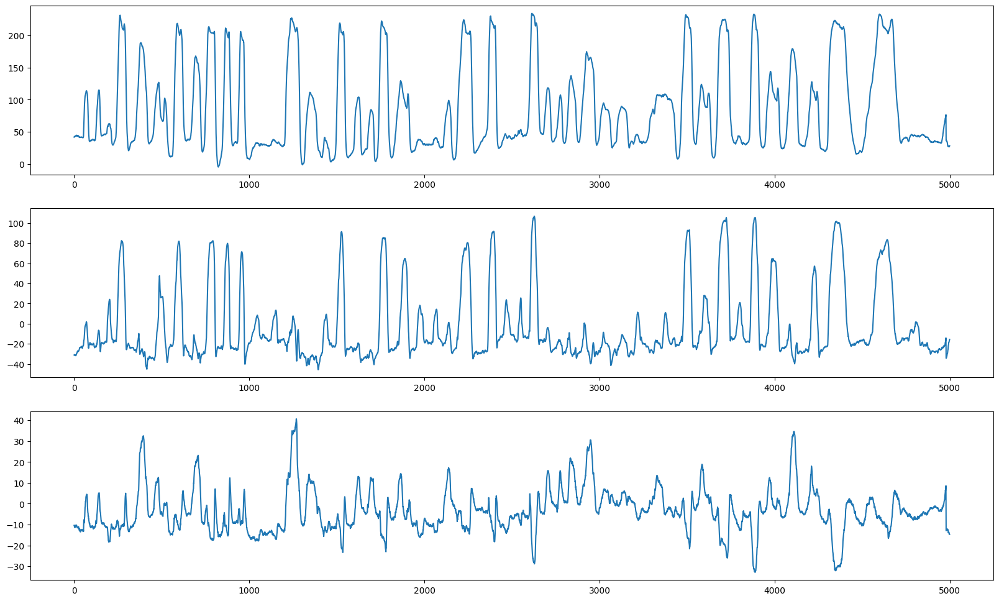

In [131]:
print(features_full_pca.shape)

plt.figure(figsize=(5*unit, 3*unit))
for i in range(3):
    y = features_full_pca[:5000,i]
    plt.subplot(3, 1, i+1)
    # plt.ylim([100, 500])
    plt.plot(list(range(len(y))), y)
plt.show()

In [133]:
print(features_full_pca.shape)

N_TRAIN = 199649
features_train_pca = features_full_pca[:N_TRAIN,:]
features_test_pca = features_full_pca[N_TRAIN:,:]

(254649, 3)
(199649, 3)
(55000, 3)


In [136]:
# Things to try:
# - Linear models
# - Linear models with centering
# - Linear models w/ reg? (& mean norm)
# - KNN (k=16 or 32) (& mean norm)

models_pca_linear = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_pca, labels_train)
    models_pca_linear[i] = reg

---Model Metrics for Finger 1---
CoD score: 0.009585810806687634
---Model Metrics for Finger 2---
CoD score: 0.17455613791922975
---Model Metrics for Finger 3---
CoD score: 0.5695293755999684
---Model Metrics for Finger 4---
CoD score: 0.5729816174222924
---Model Metrics for Finger 5---
CoD score: 0.5931742828415065


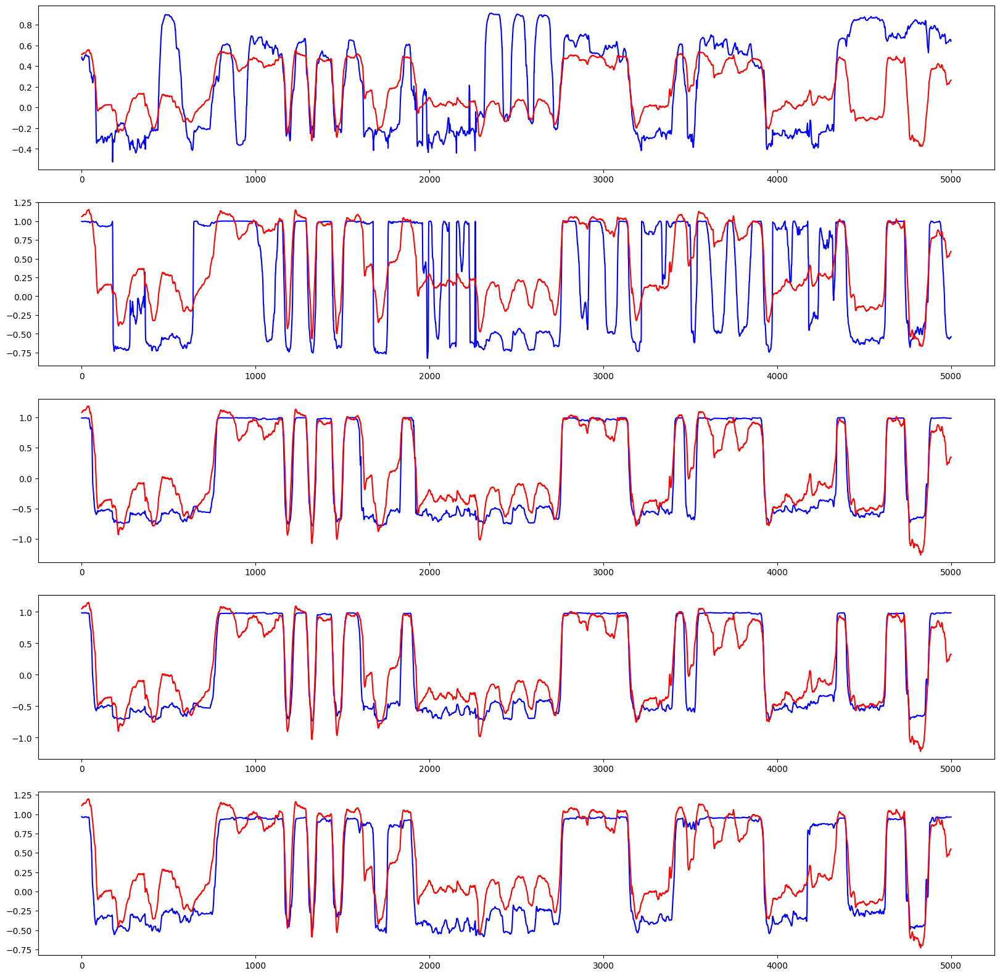

[0.009585810806687634,
 0.17455613791922975,
 0.5695293755999684,
 0.5729816174222924,
 0.5931742828415065]

In [138]:
get_model_metrics(models_pca_linear, features_test_pca, labels_test)

In [144]:
features_train_pca_norm = scale(features_train_pca)
features_test_pca_norm = scale(features_test_pca)

# np.std(features_train_pca_norm, axis=0)

array([1., 1., 1.])

---Model Metrics for Finger 1---
CoD score: 0.15725479995408842
---Model Metrics for Finger 2---
CoD score: 0.28154109345590383
---Model Metrics for Finger 3---
CoD score: 0.2981634872298079
---Model Metrics for Finger 4---
CoD score: 0.30903636303655335
---Model Metrics for Finger 5---
CoD score: 0.30053224163820424


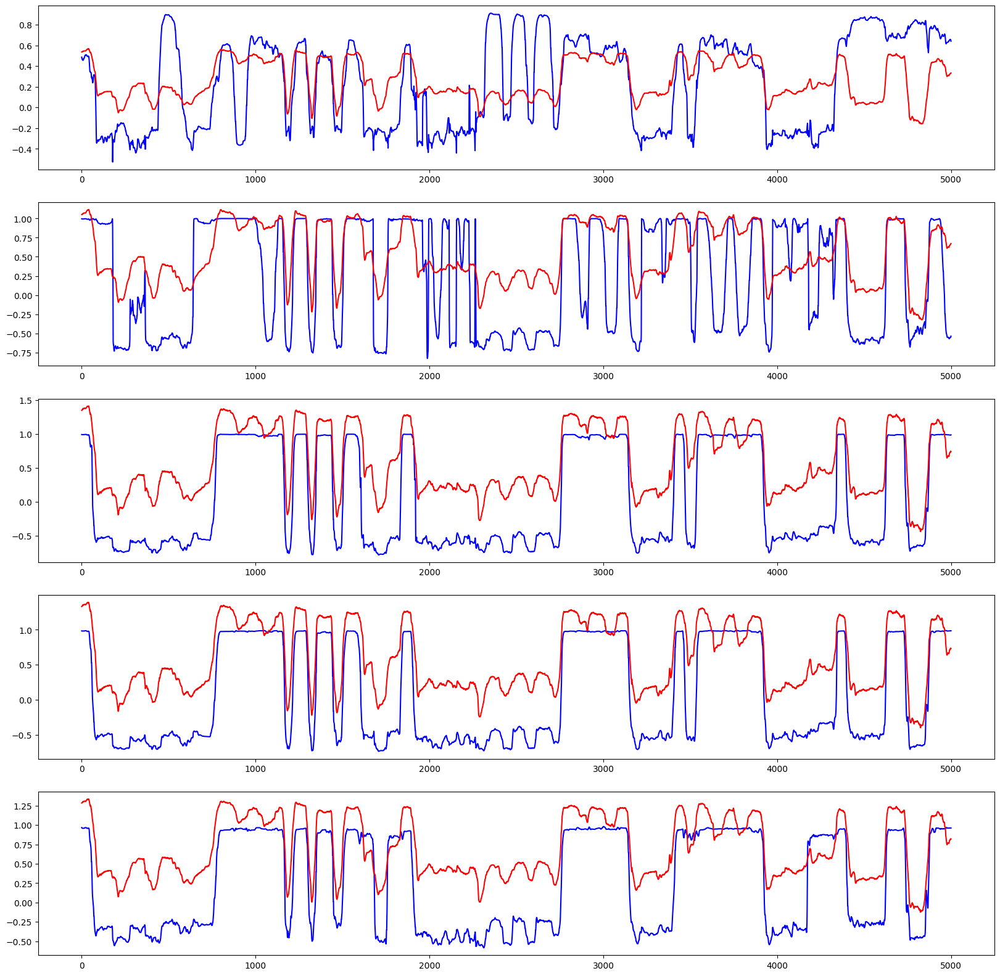

[0.15725479995408842,
 0.28154109345590383,
 0.2981634872298079,
 0.30903636303655335,
 0.30053224163820424]

In [145]:
models_pca_linear_norm = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_pca_norm, labels_train)
    models_pca_linear_norm[i] = reg

get_model_metrics(models_pca_linear_norm, features_test_pca_norm, labels_test)

---Model Metrics for Finger 1---
CoD score: 0.15801614967883437
---Model Metrics for Finger 2---
CoD score: 0.2827903191425397
---Model Metrics for Finger 3---
CoD score: 0.29775971871212914
---Model Metrics for Finger 4---
CoD score: 0.3086643201143793
---Model Metrics for Finger 5---
CoD score: 0.29968621194959344


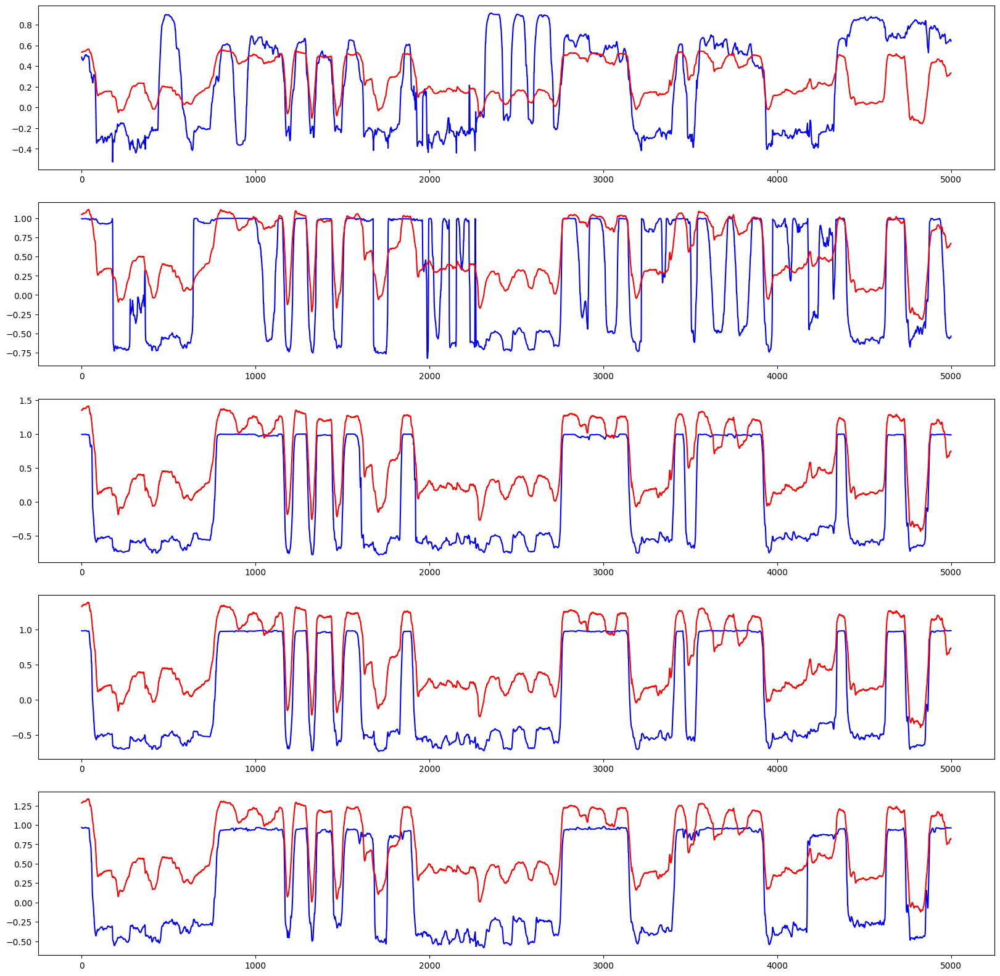

[0.15801614967883437,
 0.2827903191425397,
 0.29775971871212914,
 0.3086643201143793,
 0.29968621194959344]

In [149]:
models_pca_lasso = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = Lasso(alpha=0.001).fit(features_train_pca_norm, labels_train)
    models_pca_lasso[i] = reg

get_model_metrics(models_pca_lasso, features_test_pca_norm, labels_test)

In [151]:
# poly = PolynomialFeatures(2, include_bias=False)

features_train_pca_poly = poly.fit_transform(features_train_pca)
features_test_pca_poly = poly.fit_transform(features_test_pca)

print(features_train_pca_poly.shape)
print(features_test_pca_poly.shape)

(199649, 9)
(55000, 9)


---Model Metrics for Finger 1---
CoD score: 0.02413796342825203
---Model Metrics for Finger 2---
CoD score: 0.12330029439022816
---Model Metrics for Finger 3---
CoD score: 0.447795990133133
---Model Metrics for Finger 4---
CoD score: 0.42643886218333427
---Model Metrics for Finger 5---
CoD score: 0.40290377132830524


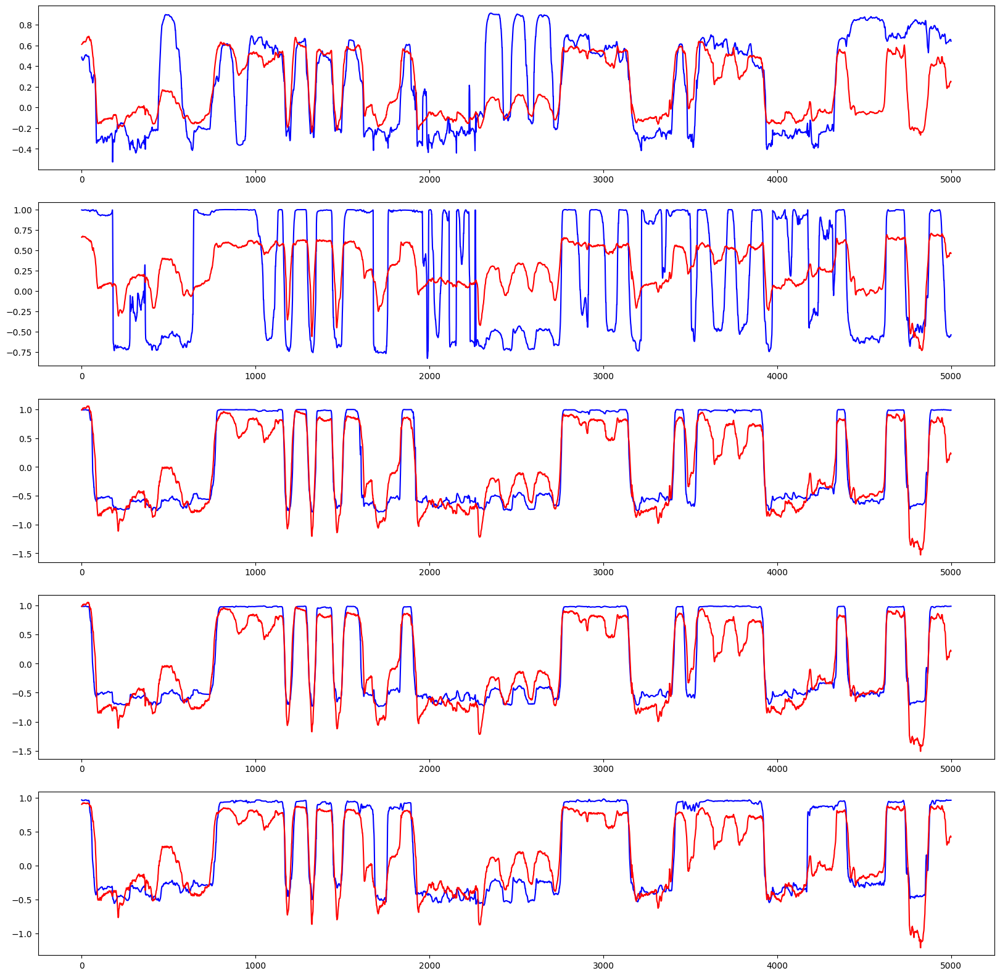

[0.02413796342825203,
 0.12330029439022816,
 0.447795990133133,
 0.42643886218333427,
 0.40290377132830524]

In [152]:
models_pca_poly_linear = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_pca_poly, labels_train)
    models_pca_poly_linear[i] = reg

get_model_metrics(models_pca_poly_linear, features_test_pca_poly, labels_test)

In [154]:
features_train_pca_poly_norm = scale(features_train_pca_poly)
features_test_pca_poly_norm = scale(features_test_pca_poly)

# np.average(features_train_pca_poly_norm, axis=0)

array([-1.35555123e-14, -4.73199275e-16, -1.59062049e-15, -6.24196480e-15,
        2.37360921e-16, -2.18778842e-15,  1.02515213e-14, -4.86439384e-15,
        6.65742107e-15])

---Model Metrics for Finger 1---
CoD score: 0.21569515963889885
---Model Metrics for Finger 2---
CoD score: 0.28462790294300944
---Model Metrics for Finger 3---
CoD score: 0.2675728678260765
---Model Metrics for Finger 4---
CoD score: 0.2860164832833161
---Model Metrics for Finger 5---
CoD score: 0.25150576747743836


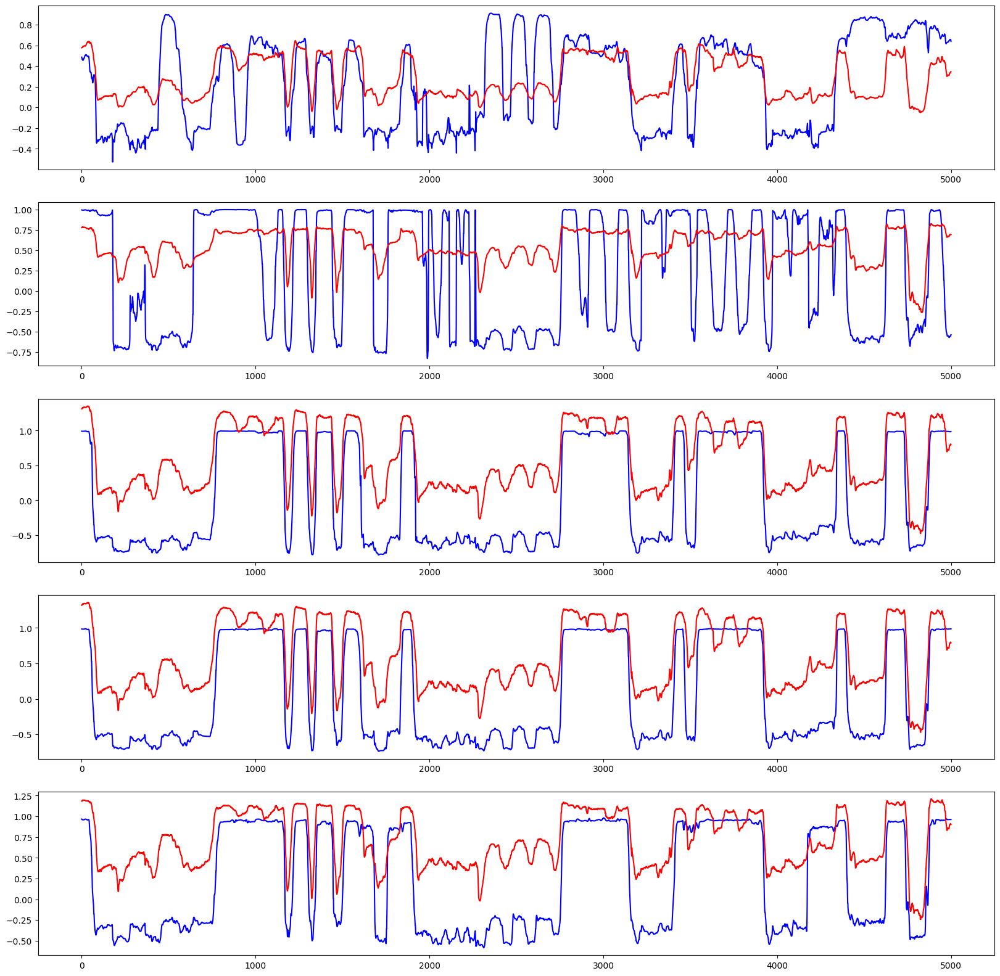

[0.21569515963889885,
 0.28462790294300944,
 0.2675728678260765,
 0.2860164832833161,
 0.25150576747743836]

In [155]:
models_pca_poly_linear_norm = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = LinearRegression().fit(features_train_pca_poly_norm, labels_train)
    models_pca_poly_linear_norm[i] = reg

get_model_metrics(models_pca_poly_linear_norm, features_test_pca_poly_norm, labels_test)

---Model Metrics for Finger 1---
CoD score: 0.0976588477721374
---Model Metrics for Finger 2---
CoD score: 0.2592192504989803
---Model Metrics for Finger 3---
CoD score: 0.16380478829663414
---Model Metrics for Finger 4---
CoD score: 0.1759315647825711
---Model Metrics for Finger 5---
CoD score: 0.09818040515533333


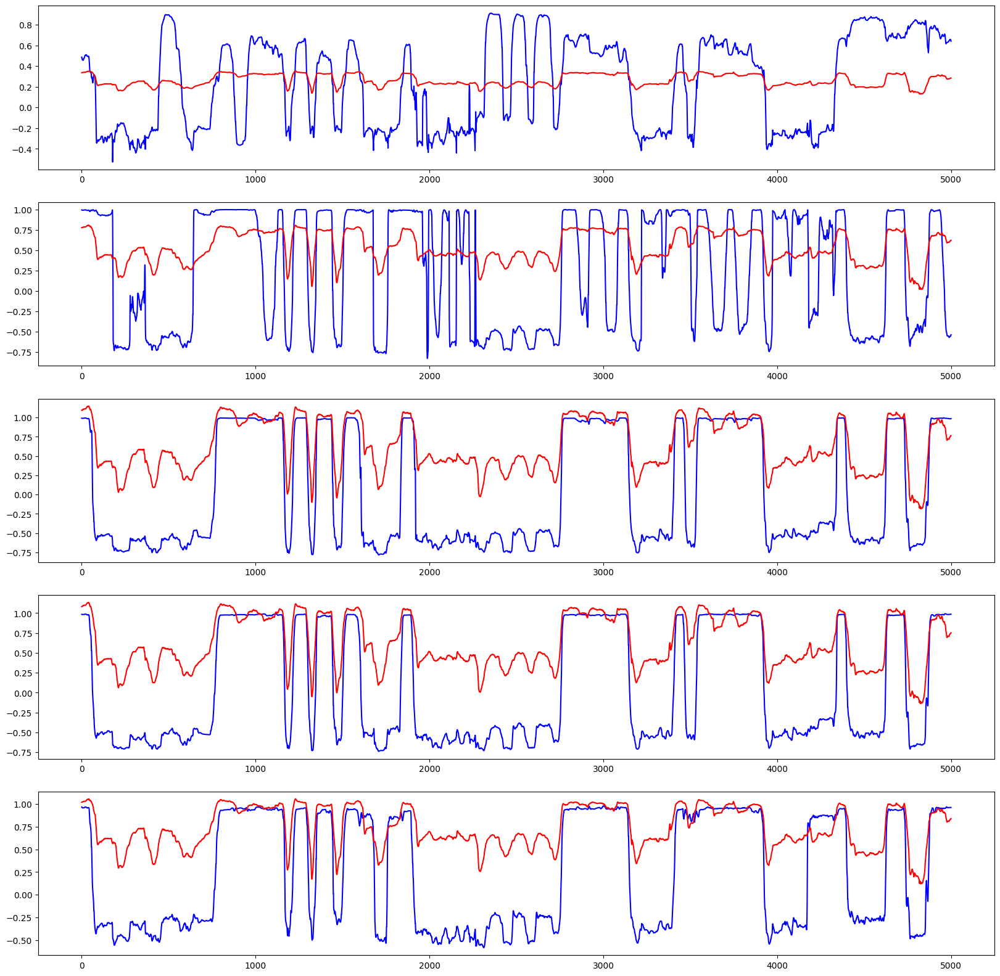

[0.0976588477721374,
 0.2592192504989803,
 0.16380478829663414,
 0.1759315647825711,
 0.09818040515533333]

In [156]:
models_pca_lasso_poly = [None]*5

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = Lasso(alpha=0.1).fit(features_train_pca_poly_norm, labels_train)
    models_pca_lasso_poly[i] = reg

get_model_metrics(models_pca_lasso_poly, features_test_pca_poly_norm, labels_test)

---Model Metrics for Finger 1---
CoD score: -0.46292417166845223
---Model Metrics for Finger 2---
CoD score: -0.5593098559876242
---Model Metrics for Finger 3---
CoD score: 0.22236438002749126
---Model Metrics for Finger 4---
CoD score: 0.23411337521038367
---Model Metrics for Finger 5---
CoD score: 0.4412030452954242


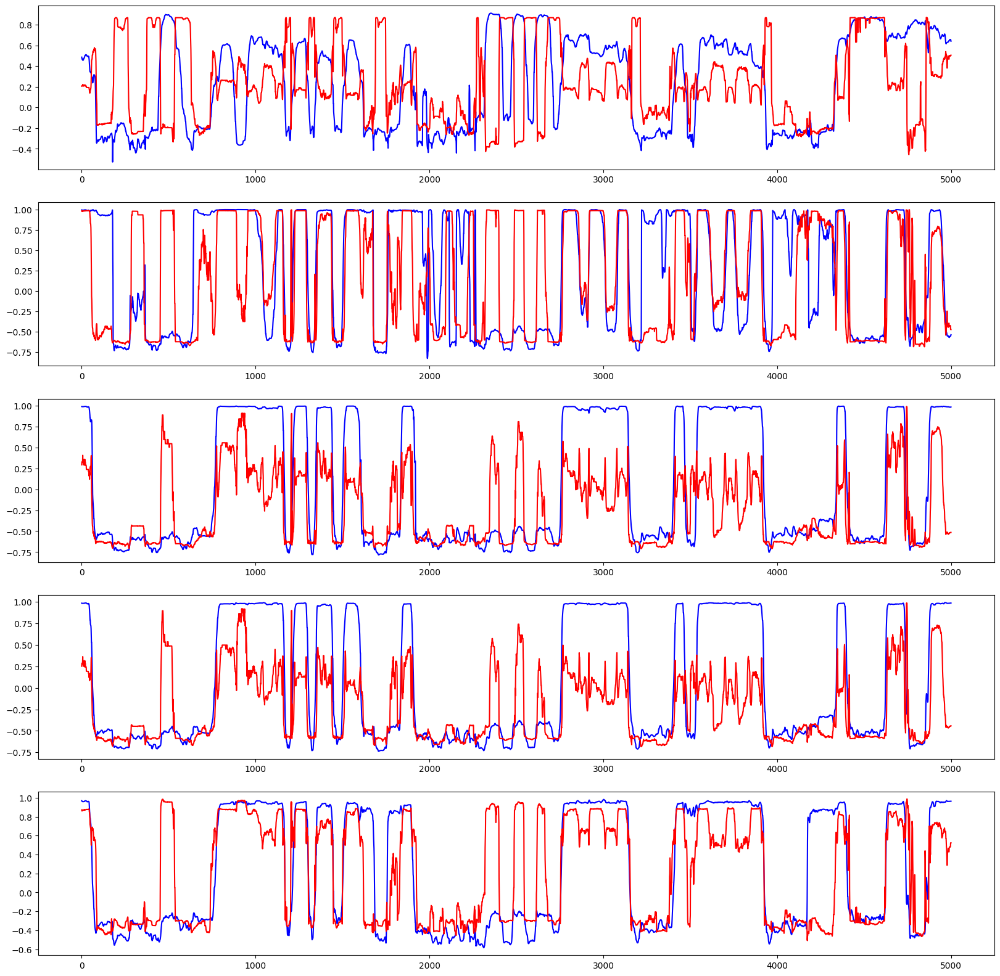

[-0.46292417166845223,
 -0.5593098559876242,
 0.22236438002749126,
 0.23411337521038367,
 0.4412030452954242]

In [158]:
models_pca_knn = [None]*5 # List of Linear models with Ridge Regression for each finger in order

for i in range(5):
    labels_train = np.vstack(labels[:40])[:,i]
    reg = KNeighborsRegressor(n_neighbors=32).fit(features_train_pca, labels_train)
    models_pca_knn[i] = reg

get_model_metrics(models_pca_knn, features_test_pca, labels_test)

In [164]:
ITERATIONS = 3000

device = torch.device('cpu')
# device = torch.device('cuda')

labels_train = np.vstack(labels[:40])

# N is batch size; D_in is input dimension;
# H is hidden dimension; D_out is output dimension.
N, D_in, H, D_out = features_train_pca.shape[0], 3, 8, 5

# Create random Tensors to hold inputs and outputs
x = torch.tensor(features_train_pca, dtype=torch.float32)
y = torch.tensor(labels_train, dtype=torch.float32)
assert x.shape == (N, D_in), f'x expected to have shape {(N, D_in)} but got shape {x.shape}'
assert y.shape == (N, D_out), f'y expected to have shape {(N, D_out)} but got shape {y.shape}'
print(f'Dimension of input: {x.shape}')
print(f'Dimension of output: {y.shape}')

model = torch.nn.Sequential(
          torch.nn.Linear(D_in, H),
          torch.nn.ReLU(),
          torch.nn.Linear(H, D_out),
        ).to(device)

loss_fn = torch.nn.MSELoss(reduction='mean')

optimizer = torch.optim.Adam(params=model.parameters(), lr=1E-3, weight_decay=1E-5)

losses_train = []
losses_test = []

learning_rate = 1e-4
for t in range(ITERATIONS):
    y_pred = model(x)

    loss = loss_fn(y_pred, y)
    if t%100 == 99:
        print(t, loss.item())
        losses_train.append(loss.item())
        loss_test = loss_fn(model(torch.tensor(features_test_pca, dtype=torch.float32)), torch.tensor(labels_test, dtype=torch.float32))
        print(t, loss_test.item())
        losses_test.append(loss_test.item())

    # Zero the gradients before running the backward pass.
    model.zero_grad()

    # Backward pass: compute gradient of the loss with respect to all the learnable
    # parameters of the model. Internally, the parameters of each Module are stored
    # in Tensors with requires_grad=True, so this call will compute gradients for
    # all learnable parameters in the model.
    loss.backward()

    optimizer.step()

Dimension of input: torch.Size([199649, 3])
Dimension of output: torch.Size([199649, 5])
99 23.56699562072754
99 18.34358024597168
199 3.4403257369995117
199 8.344520568847656
299 1.5557235479354858
299 4.873058319091797
399 1.0906543731689453
399 3.3117051124572754
499 0.819610595703125
499 2.368713140487671
599 0.6399697065353394
599 1.7539219856262207
699 0.5165643095970154
699 1.3415559530258179
799 0.4309372901916504
799 1.0595953464508057
899 0.3717128336429596
899 0.8644221425056458
999 0.3315003216266632
999 0.7306403517723083
1099 0.30460870265960693
1099 0.6402976512908936
1199 0.2867056131362915
1199 0.5795822143554688
1299 0.2745436429977417
1299 0.5383944511413574
1399 0.26571959257125854
1399 0.5097665786743164
1499 0.2586469352245331
1499 0.4886513650417328
1599 0.25247448682785034
1599 0.47201523184776306
1699 0.24681362509727478
1699 0.4581442177295685
1799 0.24135459959506989
1799 0.44587478041648865
1899 0.23602402210235596
1899 0.43486279249191284
1999 0.23083195090

---Model Metrics for Finger 1---
CoD score: -0.6663288845727
---Model Metrics for Finger 2---
CoD score: 0.19510769968242214
---Model Metrics for Finger 3---
CoD score: 0.24070365063650234
---Model Metrics for Finger 4---
CoD score: 0.3100083456789924
---Model Metrics for Finger 5---
CoD score: 0.22331443364378245


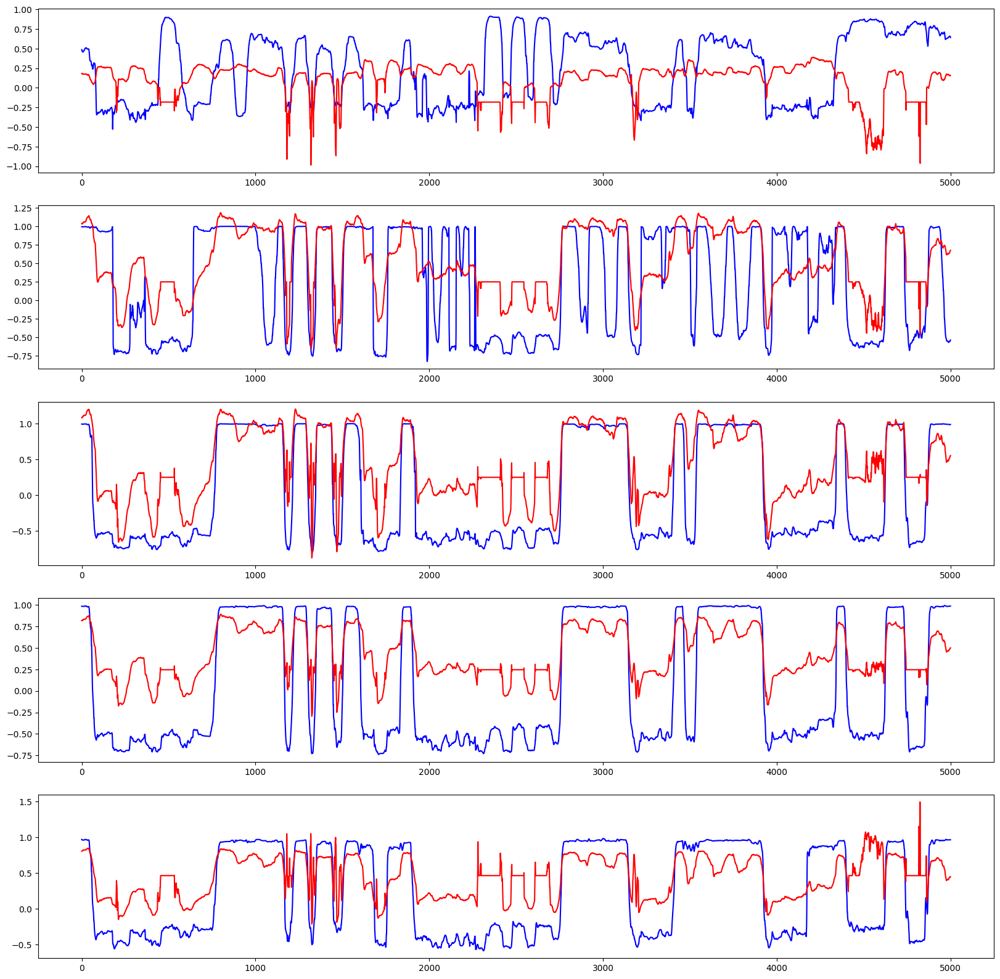

array([-0.66632888,  0.1951077 ,  0.24070365,  0.31000835,  0.22331443])

In [165]:
get_model_metrics_full(model, features_test_pca, labels_test)

## ConvNet
Using convolution to regress over history window

In [173]:
def slice_history(arr, window):
    assert window > 0 and len(arr) >= window
    return [arr[i:i+window] for i in range(0, len(arr)-window+1)]

# elements skipped is `window`-1

# features_train_sliced = slice_history(features_train[:5,:3], 3)
# print(len(features_train_sliced))
# print(features_train.shape)
# print(features_train_sliced)

[array([[341., 347., 341.],
       [341., 347., 341.],
       [341., 348., 341.]]), array([[341., 347., 341.],
       [341., 348., 341.],
       [341., 348., 341.]]), array([[341., 348., 341.],
       [341., 348., 341.],
       [341., 348., 341.]])]


In [180]:
import tensorflow as tf
from tensorflow.keras import layers, models, utils

In [192]:
# Preparing data

# N_TEST_BATCH = 40
WINDOW_SIZE = 150  # 3 seconds
N_TRAIN_CNN = len(features_train) - WINDOW_SIZE + 1
N_TEST_CNN = len(features_test) - WINDOW_SIZE + 1

features_train_sliced = slice_history(features_train, WINDOW_SIZE)  # a list of length `N_TRAIN_CNN`, each is a tensor of shape (150, 30) which is (WINDOW_SIZE, DIMENSION)
features_test_sliced = slice_history(features_test, WINDOW_SIZE)

labels_train_sliced = labels_train[WINDOW_SIZE-1:]
labels_test_sliced = labels_test[WINDOW_SIZE-1:]

assert len(features_train_sliced) == len(labels_train_sliced) == N_TRAIN_CNN
assert len(features_test_sliced) == len(labels_test_sliced) == N_TEST_CNN

# print(len(features_train_sliced))
# type(features_train_sliced[0])

# np.array(list(map(lambda xs: np.array(slice_history(xs, WINDOW_SIZE)), features)))
# print(len(features))
# print(features[0].shape)

(150, 30)


In [207]:
model = models.Sequential()
model.add(layers.Conv1D(filters=30, kernel_size=3, strides=1, padding='same', activation='relu', use_bias=True, kernel_initializer=tf.keras.initializers.RandomNormal(mean=0, stddev=5e-2), bias_initializer=tf.keras.initializers.Constant(value=0.1), input_shape=(WINDOW_SIZE,30)))
model.add(layers.Conv1D(filters=10, kernel_size=5, strides=5, padding='valid', activation='relu', use_bias=True))
model.add(layers.Conv1D(filters=10, kernel_size=7, strides=1, padding='same', activation='relu', use_bias=True))
model.add(layers.Flatten())
# model.add(layers.Dense(units=1024, activation='relu', use_bias=True, kernel_initializer=tf.keras.initializers.RandomNormal(mean=0, stddev=5e-2), bias_initializer=tf.keras.initializers.Constant(value=0.1))),
model.add(layers.Dense(units=10, activation='linear', use_bias=True, kernel_initializer=tf.keras.initializers.RandomNormal(mean=0, stddev=5e-2), bias_initializer=tf.keras.initializers.Constant(value=0.1)))
model.summary()

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_34 (Conv1D)          (None, 150, 30)           2730      
                                                                 
 conv1d_35 (Conv1D)          (None, 30, 10)            1510      
                                                                 
 conv1d_36 (Conv1D)          (None, 30, 10)            710       
                                                                 
 flatten_14 (Flatten)        (None, 300)               0         
                                                                 
 dense_15 (Dense)            (None, 10)                3010      
                                                                 
Total params: 7,960
Trainable params: 7,960
Non-trainable params: 0
_________________________________________________________________


In [209]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4), loss=tf.keras.losses.MeanSquaredError(), metrics=['arruracy'])
number_of_iterations = 2
validation_frequency = 100  
history = model.fit(features_train_sliced, labels_train_sliced, batch_size=50, epochs=number_of_iterations, validation_split=0.2, shuffle=True, steps_per_epoch=1, validation_freq=validation_frequency, verbose=2)

KeyboardInterrupt: 

In [166]:
ITERATIONS = 2000

device = torch.device('cpu')
# device = torch.device('cuda')

# N is batch size; D_in is input dimension;
# H is hidden dimension; D_out is output dimension.
N, D_in, H, D_out = features_train_norm.shape[0], 30, 70, 5

# Create random Tensors to hold inputs and outputs
x = torch.tensor(features_train_norm, dtype=torch.float32)
y = torch.tensor(labels_train, dtype=torch.float32)
assert x.shape == (N, D_in), f'x expected to have shape {(N, D_in)} but got shape {x.shape}'
assert y.shape == (N, D_out), f'y expected to have shape {(N, D_out)} but got shape {y.shape}'
print(f'Dimension of input: {x.shape}')
print(f'Dimension of output: {y.shape}')

model = torch.nn.Sequential(
          torch.nn.Conv1d(),
          torch.nn.BatchNorm1d(),
          torch.nn.ReLU(),
          torch.nn.Conv1d(),
          torch.nn.BatchNorm1d(),
          torch.nn.ReLU(),
          torch.nn.Conv1d(),
          torch.nn.BatchNorm1d(),
          torch.nn.ReLU(),
          torch.flatten(),
          torch.nn.Linear()
)

loss_fn = torch.nn.MSELoss(reduction='mean')

optimizer = torch.optim.Adam(params=model.parameters(), lr=1E-4, weight_decay=1E-5)

losses_train = []
losses_test = []

learning_rate = 1e-4



TypeError: __init__() missing 3 required positional arguments: 'in_channels', 'out_channels', and 'kernel_size'